In [4]:
import pandas as pd, gc
from time import time
from datetime import datetime
import psycopg2, traceback
import seaborn as sns
from collections import Counter
import json
from scipy.stats import chi2_contingency
from sklearn import preprocessing

import plotly, pickle
import lightgbm as lgb
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.metrics import classification_report

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [756]:
#import data
df=pd.read_csv("nyc_reports_oneMillionRows.csv")

In [757]:
# convert to timestamp
df['created_date']=pd.to_datetime(df['created_date'], infer_datetime_format=True)

# Challenge One

In [765]:
# 1. How many incidents were opened in each year (beginning with 2010)? 

#Create attibute indicating year
df['year']=df['created_date'].dt.year

#group by year and count unique service requests
result_df=df.loc[df.created_date>=datetime(2010,1,1),['unique_key','year']].groupby('year')['unique_key'].count().reset_index()
result_df.columns=['year','incidents_opened']
result_df

,year,incidents_opened
0,2010,94978
1,2011,92322
2,2012,84151
3,2013,86104
4,2014,98687
5,2015,107089
6,2016,112410
7,2017,116657
8,2018,129452
9,2019,78150


In [784]:
# 2. Which borough has the most incidents? ---- BROOKLYN

#groupby borough, count unique incidents, sort by descreasing count of incidents
sorted_df=df[['borough','unique_key']].groupby('borough')['unique_key'].count().reset_index().sort_values('unique_key',ascending=False).reset_index()
sorted_df['borough'][0]

'BROOKLYN'

In [4]:
# 1 million rows were extracted from Redshift using following code

# def query_db(query):
#     '''
#     Runs sql query on 311 database and returns a pandas DataFrame.
#     Redshift is a data warehouse based on PostgreSQL, so syntax is mostly the same
#     '''
#     host = 'interview-ds.ckgnwnm6pw4o.us-east-1.redshift.amazonaws.com'
#     port = 5439
#     db = 'interview'
#     username = 'dsguest'
#     password = 'nX9EFYUZ5Yu#0q'
    
#     conn = psycopg2.connect(host=host, port=port, dbname=db, user=username, password=password)
#     print("creating cursor")
#     cur = conn.cursor('ss cursor')
#     cur.itersize = 200000
#     print('executing query')
#     cur.execute(query)
#     print("query executed")
#     try:
        
#         rows = cur.fetchall()
#         print("executed fetchall")
#         rows = pd.DataFrame(rows)
#         print("dataframe created")
#         return rows
#     except Exception:
#         print(traceback.format_exc())
#         print()
#         print("############################################")
#         print("############################################")
#         print()
#         return cur

# #import data
# start=time()
# # df=query_db("SELECT * FROM public.three_one_one;")

# # df=query_db("select  * from public.three_one_one where unique_key in (select top 10 percent unique_key from public.three_one_one order by newid())")

# df=query_db("SELECT * FROM public.three_one_one ORDER BY RANDOM() LIMIT 1000000")

# print("time taken (mins):",round((time()-start)/60))

In [6]:
df.shape

(1000000, 41)

In [7]:
df.head()

,unique_key,created_date,closed_date,agency,agency_name,complaint_type,descriptor,location_type,incident_zip,incident_address,street_name,cross_street_1,cross_street_2,intersection_street_1,intersection_street_2,address_type,city,landmark,facility_type,status,due_date,resolution_description,resolution_action_updated_date,community_board,bbl,borough,x_coordinate_state_plane,y_coordinate_state_plane,open_data_channel_type,park_facility_name,park_borough,vehicle_type,taxi_company_borough,taxi_pick_up_location,bridge_highway_name,bridge_highway_direction,road_ramp,bridge_highway_segment,latitude,longitude,location
0,35785694,2017-03-25 08:03:05,2017-03-25 08:11:45,NYPD,New York City Police Department,Illegal Parking,Commercial Overnight Parking,Street/Sidewalk,11204.0,NaN,NaN,NaN,NaN,NEW UTRECHT AVENUE,73 STREET,INTERSECTION,BROOKLYN,NaN,Precinct,Closed,2017-03-25 16:03:05,The Police Department reviewed your complaint ...,2017-03-25 08:11:45,11 BROOKLYN,NaN,BROOKLYN,984392.0,164213.0,PHONE,Unspecified,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.617403,-73.999489,"(40.617403190607924, -73.99948851750358)"
1,37845849,2017-12-04 14:18:53,2017-12-04 18:56:01,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,10128.0,50 EAST 89 STREET,EAST 89 STREET,MADISON AVENUE,PARK AVENUE,NaN,NaN,ADDRESS,NEW YORK,NaN,Precinct,Closed,2017-12-04 22:18:53,The Police Department responded to the complai...,2017-12-04 18:56:01,08 MANHATTAN,1.015000e+09,MANHATTAN,996180.0,224393.0,MOBILE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.782575,-73.956922,"(40.782575120960765, -73.9569216683334)"
2,16030991,2010-02-18 20:30:29,2010-02-19 04:12:49,DOT,Department of Transportation,Highway Condition,Pothole - Highway,Highway,11215.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BROOKLYN,NaN,NaN,Closed,2010-02-28 20:30:29,NaN,2010-02-19 00:00:00,06 BROOKLYN,NaN,BROOKLYN,984812.0,183731.0,PHONE,Unspecified,BROOKLYN,NaN,NaN,NaN,BQE/Gowanus Expwy,East/Queens Bound,Roadway,Prospect Expwy(NY 27) (Exit 24) - Brooklyn-Que...,40.670976,-73.997974,"(40.67097587941204, -73.99797405597255)"
3,41977934,2019-03-17 01:47:27,2019-03-17 02:12:36,NYPD,New York City Police Department,Noise - Residential,Loud Music/Party,Residential Building/House,10453.0,73 WEST 174 STREET,WEST 174 STREET,MACOMBS ROAD,NELSON AVENUE,NaN,NaN,ADDRESS,BRONX,NaN,Precinct,Closed,2019-03-17 09:47:27,The Police Department reviewed your complaint ...,2019-03-17 02:12:36,05 BRONX,2.028760e+09,BRONX,1007363.0,247964.0,MOBILE,Unspecified,BRONX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.847249,-73.916460,"(40.84724872221591, -73.91645954461022)"
4,38701365,2018-03-15 22:40:00,2018-03-19 15:53:00,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Vehicle Idling (AD3)",NaN,10031.0,415 WEST 150 STREET,WEST 150 STREET,ST NICHOLAS AVE,CONVENT AVE,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,NaN,NaN,2018-03-19 15:53:00,09 MANHATTAN,1.020650e+09,MANHATTAN,999960.0,240779.0,PHONE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.827544,-73.943234,"(40.827544259287784, -73.94323403307226)"


# Challenge two

In [ ]:
# Summary of the trained model:

# Model has 69% precision and 69% recall in predicting top 21 most frequent types of complaints
# 69% recall means that model successfully identifies 69% of the incidents which will occur.
# 69% precision means that 69% of the incidents predicted by the model are correct.

# the 21 types of complaints cover 80% of the entire dataset.

#Allocation of resources can be done using this predictive model for faster & cost effective execution.

# EDA - Predicted Variable, Missing Values, Distribution of Attributes

In [14]:
# Total unique complaint types
df.complaint_type.nunique()

281

In [13]:
# Distribution of complaint types
round(df.complaint_type.value_counts()*100/df.shape[0]).astype(int).astype(str)+'%'

Noise - Residential                          8%
HEAT/HOT WATER                               5%
Street Condition                             4%
Street Light Condition                       4%
HEATING                                      4%
Blocked Driveway                             4%
Illegal Parking                              4%
PLUMBING                                     3%
Water System                                 3%
GENERAL CONSTRUCTION                         2%
General Construction/Plumbing                2%
Noise                                        2%
UNSANITARY CONDITION                         2%
Noise - Street/Sidewalk                      2%
Traffic Signal Condition                     2%
PAINT - PLASTER                              2%
Sewer                                        2%
PAINT/PLASTER                                2%
Noise - Commercial                           2%
Dirty Conditions                             2%
Request Large Bulky Item Collection     

In [15]:
# Percentage missing values in each attribute
round(df.isnull().sum()*100/df.shape[0],1).astype(int).astype(str)+'%'

unique_key                          0%
created_date                        0%
closed_date                         2%
agency                              0%
agency_name                         0%
complaint_type                      0%
descriptor                          1%
location_type                      24%
incident_zip                        6%
incident_address                   19%
street_name                        19%
cross_street_1                     33%
cross_street_2                     33%
intersection_street_1              83%
intersection_street_2              84%
address_type                        4%
city                                6%
landmark                           99%
facility_type                      74%
status                              0%
due_date                           60%
resolution_description              5%
resolution_action_updated_date      1%
community_board                     0%
bbl                                23%
borough                  

In [8]:
# Attribute data types
df.dtypes

unique_key                          int64
created_date                       object
closed_date                        object
agency                             object
agency_name                        object
complaint_type                     object
descriptor                         object
location_type                      object
incident_zip                      float64
incident_address                   object
street_name                        object
cross_street_1                     object
cross_street_2                     object
intersection_street_1              object
intersection_street_2              object
address_type                       object
city                               object
landmark                           object
facility_type                      object
status                             object
due_date                           object
resolution_description             object
resolution_action_updated_date     object
community_board                   

In [60]:
# Distribution of category attributes which have less than or equal to 100 unique categories
count=0
catCount=0

for attribute in df.columns:
    if df[attribute].dtype=='object' and 'date' not in attribute:
        catCount+=1
        if df[attribute].nunique()<=100:
            count+=1
            print('----------------------------------------------------------------------')
            print()
            print("Attribute:",attribute)
            print('Unique categories:',df[attribute].nunique())
            print('Percentage Missing Values:',str(int(round(df[attribute].isnull().sum()*100/df.shape[0])))+'%')
            print()
            
            #Percentage distribution
            distributiondf=(round(df[attribute].value_counts(normalize=True)*100).astype(int).astype(str)+'%').reset_index()
            distributiondf.columns=['category','percentage']
            print('Distribution within non-missing values:-')
            print(distributiondf)
            print()
            
            
print("Total Categorical Attributes which have less than or equal to 100 unique categories:",count)

----------------------------------------------------------------------

Attribute: agency
Unique categories: 28
Percentage Missing Values: 0%

Distribution within non-missing values:-
   category percentage
0       HPD        27%
1      NYPD        23%
2       DOT        14%
3      DSNY         9%
4       DEP         8%
5       DOB         5%
6       DPR         4%
7     DOHMH         3%
8       DOF         2%
9       TLC         1%
10      DCA         1%
11      DHS         1%
12      HRA         1%
13     DFTA         0%
14    3-1-1         0%
15      DOE         0%
16      EDC         0%
17    NYCEM         0%
18    DOITT         0%
19     DCAS         0%
20      ACS         0%
21      TAX         0%
22      DVS         0%
23     FDNY         0%
24      DCP         0%
25    DORIS         0%
26     COIB         0%
27      OMB         0%

----------------------------------------------------------------------

Attribute: address_type
Unique categories: 5
Percentage Missing Values: 5%



Percentage Missing Values: 100%

Distribution within non-missing values:-
                           category percentage
0            East/Long Island Bound         9%
1                 North/Bronx Bound         9%
2          West/Staten Island Bound         7%
3                 East/Queens Bound         7%
4                   Manhattan Bound         4%
5               West/Brooklyn Bound         4%
6              West/Manhattan Bound         4%
7         West/Toward Triborough Br         4%
8    North/Westchester County Bound         3%
9               Southbound/Downtown         3%
10                Northbound/Uptown         3%
11              East/Brooklyn Bound         3%
12                       Southbound         3%
13          South/JFK Airport Bound         3%
14                   South/Downtown         3%
15       South/Toward Triborough Br         3%
16       North/Westbound (To GW Br)         2%
17                   Brooklyn Bound         2%
18                     Queens Bou

In [61]:
# Checking if borough and park_borough attributes are same
if sum(df['borough']==df['park_borough'])==df.shape[0]:
    print("They're same!")
else:
    print("They're different!")

They're same!


In [62]:
# Distribution of category attributes which have 100 to 1000 unique categories
count=0
catCount=0
for attribute in df.columns:
    if df[attribute].dtype=='object' and 'date' not in attribute:
        catCount+=1
        if df[attribute].nunique()>100 and df[attribute].nunique()<=1000:
            count+=1
            print('----------------------------------------------------------------------')
            print()
            print("Attribute:",attribute)
            print('Unique categories:',df[attribute].nunique())
            print('Percentage Missing Values:',str(int(round(df[attribute].isnull().sum()*100/df.shape[0])))+'%')
            print()
            
            #Percentage distribution
            distributiondf=(round(df[attribute].value_counts(normalize=True)*100).astype(int).astype(str)+'%').reset_index()
            distributiondf.columns=['category','percentage']
            print('Distribution within non-missing values:-')
            print(distributiondf)
            print()
print("Total Categorical Attributes which have 100 to 1000 unique categories:",count)

----------------------------------------------------------------------

Attribute: agency_name
Unique categories: 615
Percentage Missing Values: 0%

Distribution within non-missing values:-
                                              category percentage
0    Department of Housing Preservation and Develop...        27%
1                      New York City Police Department        23%
2                         Department of Transportation        14%
3               Department of Environmental Protection         8%
4                              Department of Buildings         5%
5                   Department of Parks and Recreation         4%
6                             Department of Sanitation         3%
7              Department of Health and Mental Hygiene         3%
8                        Taxi and Limousine Commission         1%
9                       Department of Consumer Affairs         1%
10                                BCC - Brooklyn South         1%
11                

----------------------------------------------------------------------

Attribute: complaint_type
Unique categories: 281
Percentage Missing Values: 0%

Distribution within non-missing values:-
                                      category percentage
0                          Noise - Residential         8%
1                               HEAT/HOT WATER         5%
2                             Street Condition         4%
3                       Street Light Condition         4%
4                                      HEATING         4%
5                             Blocked Driveway         4%
6                              Illegal Parking         4%
7                                     PLUMBING         3%
8                                 Water System         3%
9                         GENERAL CONSTRUCTION         2%
10               General Construction/Plumbing         2%
11                                       Noise         2%
12                        UNSANITARY CONDITION       

----------------------------------------------------------------------

Attribute: location_type
Unique categories: 154
Percentage Missing Values: 25%

Distribution within non-missing values:-
                                 category percentage
0                    RESIDENTIAL BUILDING        36%
1                         Street/Sidewalk        17%
2                                  Street        13%
3              Residential Building/House        11%
4                                Sidewalk         9%
5                        Property Address         1%
6                        Store/Commercial         1%
7                     Club/Bar/Restaurant         1%
8                          Senior Address         1%
9                                    Park         1%
10                3+ Family Apt. Building         1%
11                     NYC Street Address         1%
12             Restaurant/Bar/Deli/Bakery         1%
13                    1-2 Family Dwelling         1%
14          

----------------------------------------------------------------------

Attribute: city
Unique categories: 413
Percentage Missing Values: 6%

Distribution within non-missing values:-
                   category percentage
0                  BROOKLYN        32%
1                  NEW YORK        20%
2                     BRONX        19%
3             STATEN ISLAND         5%
4                   JAMAICA         1%
5                  FLUSHING         1%
6                   Jamaica         1%
7                   ASTORIA         1%
8                  Flushing         1%
9                 RIDGEWOOD         1%
10                  Astoria         1%
11                Ridgewood         1%
12                   CORONA         1%
13                 WOODSIDE         0%
14               OZONE PARK         0%
15                 ELMHURST         0%
16            EAST ELMHURST         0%
17             FOREST HILLS         0%
18            FRESH MEADOWS         0%
19             Far Rockaway         0

----------------------------------------------------------------------

Attribute: taxi_pick_up_location
Unique categories: 706
Percentage Missing Values: 99%

Distribution within non-missing values:-
                                              category percentage
0                                                Other        64%
1                                         Intersection         8%
2                                          JFK Airport         8%
3                                   La Guardia Airport         5%
4                                New York-Penn Station         2%
5                          Port Authority Bus Terminal         1%
6                                Grand Central Station         1%
7                                    NEW YORK NY 10003         0%
8                                    NEW YORK NY 10009         0%
9             JFK AIRPORT, QUEENS (JAMAICA) ,NY, 11430         0%
10                                  BEND ANDBENDQUEENS         0%
11     

----------------------------------------------------------------------

Attribute: bridge_highway_segment
Unique categories: 909
Percentage Missing Values: 100%

Distribution within non-missing values:-
                                              category percentage
0                                                 Ramp         4%
1                                              Roadway         3%
2    Clove Rd/Richmond Rd (Exit 13) - Lily Pond Ave...         1%
3    Flatbush Ave (Exit 11N) - Flatbush Ave (Exit 11S)         1%
4    East 61st St / East 63rd St (Exit 12) - East 9...         1%
5                                          Lower Level         1%
6                                        Outer Roadway         1%
7                                             Bikepath         1%
8     East 96th St (Exit 14) - Triborough Br (Exit 17)         1%
9    Grand Central Pkwy / Van Wyck Expwy / College ...         1%
10        Queens Blvd (NY 25)/Woodhaven Blvd (Exit 19)         0%
11   

Total Categorical Attributes which have 100 to 1000 unique categories: 6


In [67]:
# Category attributes which have more than 1000 unique categories
moreThan_1000_unique=[]
count=0
for attribute in df.columns:
    if df[attribute].dtype=='object' and 'date' not in attribute:
        
        if df[attribute].nunique()>1000:
            count+=1
            moreThan_1000_unique.append(attribute)
            print('Attribute:',attribute,'------------',df[attribute].nunique(),'unique categories')
print()
print('Total category attributes with more than 1000 unique categories:',count)
print()

#show
(df[moreThan_1000_unique].head())

Attribute: descriptor ------------ 1354 unique categories
Attribute: incident_address ------------ 339724 unique categories
Attribute: street_name ------------ 14707 unique categories
Attribute: cross_street_1 ------------ 16005 unique categories
Attribute: cross_street_2 ------------ 16285 unique categories
Attribute: intersection_street_1 ------------ 10446 unique categories
Attribute: intersection_street_2 ------------ 10967 unique categories
Attribute: landmark ------------ 2561 unique categories
Attribute: resolution_description ------------ 1231 unique categories
Attribute: park_facility_name ------------ 1785 unique categories
Attribute: location ------------ 368707 unique categories

Total category attributes with more than 1000 unique categories: 11

Visualize:-


,descriptor,incident_address,street_name,cross_street_1,cross_street_2,intersection_street_1,intersection_street_2,landmark,resolution_description,park_facility_name,location
0,Commercial Overnight Parking,NaN,NaN,NaN,NaN,NEW UTRECHT AVENUE,73 STREET,NaN,The Police Department reviewed your complaint ...,Unspecified,"(40.617403190607924, -73.99948851750358)"
1,No Access,50 EAST 89 STREET,EAST 89 STREET,MADISON AVENUE,PARK AVENUE,NaN,NaN,NaN,The Police Department responded to the complai...,Unspecified,"(40.782575120960765, -73.9569216683334)"
2,Pothole - Highway,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unspecified,"(40.67097587941204, -73.99797405597255)"
3,Loud Music/Party,73 WEST 174 STREET,WEST 174 STREET,MACOMBS ROAD,NELSON AVENUE,NaN,NaN,NaN,The Police Department reviewed your complaint ...,Unspecified,"(40.84724872221591, -73.91645954461022)"
4,"Air: Odor/Fumes, Vehicle Idling (AD3)",415 WEST 150 STREET,WEST 150 STREET,ST NICHOLAS AVE,CONVENT AVE,NaN,NaN,NaN,NaN,Unspecified,"(40.827544259287784, -73.94323403307226)"


In [64]:
# Showing attributes which have details on address of locations

(df[['street_name','cross_street_1','intersection_street_1','incident_address']].head(20))

,street_name,cross_street_1,intersection_street_1,incident_address
0,NaN,NaN,NEW UTRECHT AVENUE,NaN
1,EAST 89 STREET,MADISON AVENUE,NaN,50 EAST 89 STREET
2,NaN,NaN,NaN,NaN
3,WEST 174 STREET,MACOMBS ROAD,NaN,73 WEST 174 STREET
4,WEST 150 STREET,ST NICHOLAS AVE,NaN,415 WEST 150 STREET
5,HAVILAND AVENUE,NaN,NaN,2250 HAVILAND AVENUE
6,GARY STREET,DIERAUF STREET,NaN,83 GARY STREET
7,NaN,NaN,67 ST W,NaN
8,MERRYMOUNT STREET,NOME AVENUE,NaN,295 MERRYMOUNT STREET
9,AVENUE W,BATCHELDER STREET,NaN,3040 AVENUE W


In [73]:
# Attributes which have date
date_attributes=[x for x in df.columns if 'date' in x.lower()]

print(df[date_attributes].head())
print()
print('Total attributes which have date:',df[date_attributes].shape[1])

         created_date          closed_date             due_date  \
0 2017-03-25 08:03:05  2017-03-25 08:11:45  2017-03-25 16:03:05   
1 2017-12-04 14:18:53  2017-12-04 18:56:01  2017-12-04 22:18:53   
2 2010-02-18 20:30:29  2010-02-19 04:12:49  2010-02-28 20:30:29   
3 2019-03-17 01:47:27  2019-03-17 02:12:36  2019-03-17 09:47:27   
4 2018-03-15 22:40:00  2018-03-19 15:53:00                  NaN   

  resolution_action_updated_date  
0            2017-03-25 08:11:45  
1            2017-12-04 18:56:01  
2            2010-02-19 00:00:00  
3            2019-03-17 02:12:36  
4            2018-03-19 15:53:00  

Total attributes which have date: 4


In [74]:
# Numeric attributes

print('Total Numeric Attributes:',df.describe().shape[1])
df.describe()

Total Numeric Attributes 7


,unique_key,incident_zip,bbl,x_coordinate_state_plane,y_coordinate_state_plane,latitude,longitude
count,1.000000e+06,940409.000000,7.667580e+05,9.075450e+05,907545.000000,907545.000000,907545.000000
mean,3.058169e+07,10828.032970,2.762766e+09,1.005219e+06,205230.196625,40.729932,-73.924303
std,7.772701e+06,858.822722,1.169231e+09,2.258309e+04,31605.062243,0.086749,0.081440
min,1.141358e+07,0.000000,0.000000e+00,9.133570e+05,121152.000000,40.498949,-74.254937
25%,2.421529e+07,10314.000000,2.028400e+09,9.933180e+05,182052.000000,40.666344,-73.967308
50%,3.088540e+07,11205.000000,3.020320e+09,1.004405e+06,202120.000000,40.721379,-73.927155
75%,3.731415e+07,11234.000000,4.008650e+09,1.018017e+06,234097.000000,40.809190,-73.878094
max,4.359104e+07,317707.000000,5.080500e+09,1.067302e+06,271876.000000,40.912869,-73.700292


In [78]:
#Checking if we have seen all attributes 
#([less than 100 unique categories]+[100 to 1000 unique categories]+[more than 1000 unique categories]+[date type]+[numeric attributes])

(13+6+11+4+7)==df.shape[1]  

True

In [80]:
#creating 3 features - whether incident took place in taxi, on bridge or in a park
# df['is_taxi']=None
# print(df.is_taxi.isnull().sum())
# df.loc[df.taxi_pick_up_location.notnull(),'is_taxi']=1
# df.loc[df.taxi_pick_up_location.isnull(),'is_taxi']=0
# print(df.is_taxi.isnull().sum(),df.is_taxi.value_counts())

# df['is_bridge']=None
# print(df.is_bridge.isnull().sum())
# df.loc[df.bridge_highway_direction.notnull(),'is_bridge']=1
# df.loc[df.bridge_highway_direction.isnull(),'is_bridge']=0
# print(df.is_bridge.isnull().sum(),df.is_bridge.value_counts())

# df['is_park']=None
# print(df.is_park.isnull().sum())
# df.loc[(df.park_facility_name.notnull())&(df.park_facility_name!='Unspecified'),'is_park']=1
# df.loc[(df.park_facility_name.isnull())|(df.park_facility_name=='Unspecified'),'is_park']=0
# print(df.is_park.isnull().sum(),df.is_park.value_counts())

In [ ]:
# Lists of attributes to be dropped (not to be used for making predictions)---we'll be dropping them later in the notebook

# attributes which have too many missing values 
drop_missing=['landmark','vehicle_type',
              "taxi_company_borough","taxi_pick_up_location","bridge_highway_name","bridge_highway_direction",
              "road_ramp","bridge_highway_segment",'park_facility_name']

# Using these attributes will make the model redundant for practical use..
drop_notUseful=['status','due_date','resolution_description','descriptor','closed_date',
                'resolution_action_updated_date','facility_type']

# attributes which have too many unique categories
drop_tooManyUniqueValues=['incident_address','location','agency_name','bbl']

# Attributes not useful due to other similar attributes
drop_used=['park_borough','street_name']

# Feature Creation

In [85]:
# Analyzing Most frequently occuring words in the address of incident.

df['incident_address']=df['incident_address'].astype(str)

#List of all words
split_it=" ".join(df.incident_address.tolist()).lower().split()

# Finding the 40 most frequent words using counter
Counter = Counter(split_it)
most_occur = Counter.most_common(40)

print('Top 40 most frequent words and their frequencies:-')
print(most_occur)


Top 40 most frequent words and their frequencies:-
[('street', 348284), ('avenue', 306928), ('nan', 193446), ('east', 85524), ('west', 61520), ('place', 28270), ('boulevard', 27124), ('road', 26203), ('st', 12327), ('parkway', 12076), ('park', 9893), ('broadway', 9890), ('grand', 9488), ('drive', 6930), ('ocean', 6528), ('beach', 6492), ('3', 6212), ('concourse', 6042), ('2', 5893), ('5', 5864), ('south', 5392), ('1', 5201), ('7', 4894), ('10', 4727), ('4', 4555), ('21', 4514), ('8', 4495), ('bay', 4127), ('14', 4003), ('34', 3967), ('9', 3950), ('north', 3876), ('nicholas', 3780), ('12', 3694), ('15', 3653), ('court', 3488), ('new', 3481), ('19', 3456), ('35', 3449), ('union', 3422)]


In [750]:
# Creating Address Features
# Indicating whether addresses are Street, Avenue, Boulevard, Road, Parkway, Broadway, Concourse, Drive or Park

# Function to create features from address type attributes
def useAddressInfo(string):
    
    infoMap={'avenue':['avenue','ave'],'street':['street','st'],'boulevard':['boulevard','bvld'],'road':['road','rd'],
            'parkway':['parkway','pkwy'],'broadway':['broadway'],'concourse':['concourse'],'drive':['drive','dr'], 'park':['park']}
    
    flag=0
    split_set=set(string.lower().split()[:15])
    for info in infoMap.keys():
        if not set(infoMap[info]).isdisjoint(split_set):
            return info
            
    return 'Not found'

In [751]:
#apply address function to 5 attributes 

for column in ['incident_address','cross_street_1','cross_street_2','intersection_street_1','intersection_street_2']:
    df[column]=df[column].astype(str)
    print(column)
    df[column+'_type']=df[column].apply(useAddressInfo)
    

incident_address
3.8953192234039307
cross_street_1
7.69951605796814
cross_street_2
11.42151403427124
intersection_street_1
16.279202461242676
intersection_street_2
21.328097820281982


In [37]:
# df.to_csv("nyc_1.csv",index=False)

In [94]:
# df=pd.read_csv("nyc_1.csv")

In [95]:
# Types of locations
[x for x in df.location_type.value_counts().index]

['RESIDENTIAL BUILDING',
 'Street/Sidewalk',
 'Street',
 'Residential Building/House',
 'Sidewalk',
 'Property Address',
 'Store/Commercial',
 'Club/Bar/Restaurant',
 'Senior Address',
 'Park',
 '3+ Family Apt. Building',
 'NYC Street Address',
 'Restaurant/Bar/Deli/Bakery',
 '1-2 Family Dwelling',
 'Lot',
 'Tenant Address',
 'Mixed Use',
 '3+ Family Apartment Building',
 '1-, 2- and 3- Family Home',
 'Park/Playground',
 'Comercial',
 'Highway',
 'Other (Explain Below)',
 'Commercial Building',
 'Co-Op Unit',
 'Residential',
 'Street Address',
 'Residential Building',
 '3+ Family Mixed Use Building',
 'Other',
 'School',
 'Bus Stop Shelter',
 'Street/Curbside',
 'Curb',
 'Building (Non-Residential)',
 'House of Worship',
 'Address Outside of NYC',
 'Vacant Lot',
 'Above Address',
 'Home',
 '1-2 Family Mixed Use Building',
 'Condo Unit',
 'Public/Unfenced Area',
 'Address',
 'Apartment Building',
 'Bridge',
 'Government/Not-for Profit',
 'Commercial',
 'Street and Sidewalk',
 'Construct

In [96]:
# Combine location types which are very similar

#mapping lists
residential=['Residential','Residential Building','Residential Building/House','Apartment Building','Curb','Home',
             'Condo Unit','Residence','Residential Property',
             '3+ Family Apt. Building','3+ Family Apartment Building','1-2 Family Dwelling','1-, 2- and 3- Family Home']
street_sidewalk=['Street', 'Sidewalk','NYC Street Address','Street Address','Street and Sidewalk','Street/Curbside']

store_commercial = ['Comercial','Commercial Building','Commercial']
mixed_use = ['3+ Family Mixed Use Building','1-2 Family Mixed Use Building']

#combining
df.loc[df.location_type.isin(residential),'location_type']='RESIDENTIAL BUILDING'
df.loc[df.location_type.isin(street_sidewalk),'location_type']='Street/Sidewalk'
df.loc[df.location_type=='Park/Playground','location_type']='Park'
df.loc[df.location_type.isin(store_commercial),'location_type']='Store/Commercial'
df.loc[df.location_type.isin(mixed_use),'location_type']='Mixed Use'
df.loc[df.location_type=='Vacant Lot','location_type']='Lot'
df.loc[df.location_type=='Bar/Restaurant','location_type']='Club/Bar/Restaurant'

In [97]:
# Combine all location types which occur less than 1000 times

df['groupCount']=df.groupby('location_type')['unique_key'].transform(len)

#assigning value 'Other'
df.loc[df.groupCount<1000,'location_type']='Other'

#drop
df.drop('groupCount',axis=1,inplace=True)

In [98]:
#corner case for combining location types - assigning value 'Other'
df.loc[df.location_type=='Other (Explain Below)','location_type']='Other'

In [99]:
df.location_type.value_counts()

RESIDENTIAL BUILDING          373453
Street/Sidewalk               297488
Store/Commercial               13095
Other                          11809
Property Address                9886
Park                            9009
Club/Bar/Restaurant             8734
Senior Address                  7941
Restaurant/Bar/Deli/Bakery      4681
Lot                             4441
Mixed Use                       4294
Tenant Address                  3424
Highway                         2196
Co-Op Unit                      1380
Name: location_type, dtype: int64

In [102]:
# Percentage missing location types
print(df.location_type.isnull().sum()*100/df.shape[0],'%')

24.8169 %


In [114]:
# Create attribute indicating day of week of the incident
df['created_date']=pd.to_datetime(df['created_date'],infer_datetime_format=True)

df['dayOfWeek']=df['created_date'].apply(lambda x: x.weekday())

In [115]:
# Create attribute indicating whether incident happened on a weekend(Fri-Sun)
df['is_weekend']=None
df.loc[df.dayOfWeek>=4,'is_weekend']='Yes'
df.loc[df.dayOfWeek<4,'is_weekend']='No'
# df.is_weekend.value_counts()

In [116]:
#Converting day of week numeric values to category values

#function to convert numeric day of week values to category 
def weekday(day):
    if day==0:
        return "Monday"
    elif day==1:
        return "Tuesday"
    elif day==2:
        return "Wednesday"
    elif day==3:
        return "Thursday"
    elif day==4:
        return "Friday"
    elif day==5:
        return "Saturday"
    elif day==6:
        return "Sunday"
    
# convert to category type 
df['dayOfWeek']=df['dayOfWeek'].apply(weekday)

In [117]:
# Create attribute indicating month

df['month']=df['created_date'].apply(lambda x: x.month)

#function to convert numeric month values to category values 
def monthname(month):
    if month==1:
        return "Jan"
    elif month==2:
        return "Feb"
    elif month==3:
        return "Mar"
    elif month==4:
        return "Apr"
    elif month==5:
        return "May"
    elif month==6:
        return "Jun"
    elif month==7:
        return "Jul"
    elif month==8:
        return "Aug"
    elif month==9:
        return "Sep"
    elif month==10:
        return "Oct"
    elif month==11:
        return "Nov"
    elif month==12:
        return "Dec"
    
# convert to category type 
df['month']=df['month'].apply(monthname)

In [118]:
#Create attribute indicating hour of day 
df['hour']=df['created_date'].apply(lambda x: x.hour)

In [122]:
# Create attribute indicating the phase of the day

#function to convert hour of the day to its corresponding phase
def day_part(hour):
    if hour in [4,5]:
        return "dawn"
    elif hour in [6,7]:
        return "early morning"
    elif hour in [8,9,10]:
        return "late morning"
    elif hour in [11,12,13]:
        return "noon"
    elif hour in [14,15,16]:
        return "afternoon"
    elif hour in [17, 18,19]:
        return "evening"
    elif hour in [20, 21, 22]:
        return "night"
    elif hour in [23,24,1,2,3]:
        return "midnight"

# applying the function
df['phase_of_Day']=df['hour'].apply(day_part)

In [123]:
df[['created_date','phase_of_Day']].head()

,created_date,phase_of_Day
0,2017-03-25 08:03:05,late morning
1,2017-12-04 14:18:53,afternoon
2,2010-02-18 20:30:29,night
3,2019-03-17 01:47:27,midnight
4,2018-03-15 22:40:00,night


In [124]:
# Create attribute indicating season

# function to convert month to season
def findSeason(month):
    
    #months chosen based on: https://www.nyc.com/visitor_guide/weather_facts.75835/
    if month in ['Dec','Jan','Feb']:
        return 'Winter'
    if month in ['Mar','Apr','May']:
        return 'Spring'
    if month in ['Jun','Jul','Aug']:
        return 'Summer'
    if month in ['Sep','Oct','Nov']:
        return 'Fall'
    return 'Not Found'

#applying the function
df['season']=df['month'].apply(findSeason)

In [82]:
# df.to_csv("nyc_2.csv",index=False)

In [127]:
# save dataframe as pickle file
with open('nyc_afterFormatting.pkl','wb') as file:
    pickle.dump(df,file)

In [462]:
# load dataframe 
with open('nyc_afterFormatting.pkl','rb') as file:
    df=pickle.load(file)

In [292]:
df.shape,df.columns

((1000000, 55),
 Index(['unique_key', 'created_date', 'closed_date', 'agency', 'agency_name',
        'complaint_type', 'descriptor', 'location_type', 'incident_zip',
        'incident_address', 'street_name', 'cross_street_1', 'cross_street_2',
        'intersection_street_1', 'intersection_street_2', 'address_type',
        'city', 'landmark', 'facility_type', 'status', 'due_date',
        'resolution_description', 'resolution_action_updated_date',
        'community_board', 'bbl', 'borough', 'x_coordinate_state_plane',
        'y_coordinate_state_plane', 'open_data_channel_type',
        'park_facility_name', 'park_borough', 'vehicle_type',
        'taxi_company_borough', 'taxi_pick_up_location', 'bridge_highway_name',
        'bridge_highway_direction', 'road_ramp', 'bridge_highway_segment',
        'latitude', 'longitude', 'location', 'is_taxi', 'is_bridge', 'is_park',
        'incident_address_type', 'cross_street_1_type', 'cross_street_2_type',
        'intersection_street_1_typ

In [294]:
#Create attibute indicating day of the month
df['day_of_month']=df['created_date'].dt.day

In [295]:
#Create attibute indicating day of the year
df['day_of_year']=df['created_date'].dt.day_of_year

In [296]:
#Create attibute indicating year
df['year']=df['created_date'].dt.year

In [297]:
# Create attribute indicating some key city areas

def downtown(zipCode):
    if zipCode in [11201,11217]:
        return 1
    else:
        return 0
    
def lowerManhattan(zipCode):
    if zipCode in [10004, 10005, 10006, 10007, 10038, 10280, 10012, 10013, 10014]:
        return 1
    else:
        return 0

def midtownManhattan(zipCode):
    if zipCode in [10001,10016,10017,10018,10019,10022,10036,10003,10009,10010,10011]:
        return 1
    else:
        return 0
    
def longIslandCity(zipCode):
    if zipCode in [11101,11102,11103,11104,11105,11106, 11109, 11120]:
        return 1
    else:
        return 0
    
def downtownFlushing(zipCode):
    if zipCode in [11354, 11355, 11358]:
        return 1
    else:
        return 0
    
    
#Applying functions to dataset
df['is_downtown']=df['incident_zip'].apply(downtown).astype(str)
df['is_lowerManhattan']=df['incident_zip'].apply(lowerManhattan).astype(str)
df['is_midtownManhattan']=df['incident_zip'].apply(midtownManhattan).astype(str)
df['is_longIslandCity']=df['incident_zip'].apply(longIslandCity).astype(str)
df['is_downtownFlushing']=df['incident_zip'].apply(downtownFlushing).astype(str)

In [298]:
# Combining cities with low incidents into one category named 'Other'. Cities not in top 15 cities have been combined.
df.loc[~df.city.isin(df['city'].value_counts().reset_index()['index'][:15]),'city']='Other'

df.city.nunique()

16

# Final Data Preparation for Predictive Modeling

In [176]:
# Lists of attributes to be dropped (not to be used for making predictions) 

# attributes which have too many missing values 
drop_missing=['landmark','vehicle_type',
              "taxi_company_borough","taxi_pick_up_location","bridge_highway_name","bridge_highway_direction",
              "road_ramp","bridge_highway_segment",'park_facility_name']

# Using these attributes will make the model redundant for practical use..
drop_notUseful=['status','due_date','resolution_description','descriptor','closed_date','open_data_channel_type',
                'resolution_action_updated_date','facility_type']

# attributes which have too many unique categories
drop_tooManyUniqueValues=['incident_address','location','agency_name','bbl']

# Attributes not useful due to other similar attributes
drop_used=['park_borough','street_name']

In [ ]:
# Dropping attributes from dataset
df=df.drop(drop_missing+drop_notUseful+drop_tooManyUniqueValues+drop_used,axis=1)

In [178]:
df.shape

(1000000, 27)

In [160]:
round(100*df.isnull().sum()/df.shape[0]).astype(int).astype(str)+'%'

unique_key                     0%
complaint_type                 0%
location_type                 25%
incident_zip                   6%
cross_street_1                33%
cross_street_2                34%
intersection_street_1         84%
intersection_street_2         84%
address_type                   5%
city                           0%
facility_type                 74%
community_board                0%
borough                        0%
x_coordinate_state_plane       9%
y_coordinate_state_plane       9%
open_data_channel_type         0%
latitude                       9%
longitude                      9%
is_taxi                        0%
is_bridge                      0%
is_park                        0%
incident_address_type          0%
cross_street_1_type            0%
cross_street_2_type            0%
intersection_street_1_type     0%
intersection_street_2_type     0%
dayOfWeek                      0%
is_weekend                     0%
month                          0%
hour          

In [161]:
# Dropping due to too many missing values
df=df.drop(['intersection_street_1_type','intersection_street_2_type','intersection_street_1','intersection_street_2'],axis=1)

In [162]:
# Dropping as they've been used already for creating features
df=df.drop(['cross_street_1','cross_street_2'],axis=1)

In [164]:
#statistics of numeric attributes
df.describe()

,unique_key,incident_zip,x_coordinate_state_plane,y_coordinate_state_plane,latitude,longitude,is_taxi,is_bridge,is_park,hour,day_of_month,day_of_year,is_downtown,is_lowerManhattan,is_midtownManhattan,is_longIslandCity,is_downtownFlushing
count,1.000000e+06,940409.000000,9.075450e+05,907545.000000,907545.000000,907545.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.00000,1000000.000000,1000000.000000
mean,3.058169e+07,10828.032970,1.005219e+06,205230.196625,40.729932,-73.924303,0.007599,0.002472,0.006385,10.860996,15.663891,176.742475,0.012071,0.019330,0.05168,0.024130,0.014629
std,7.772701e+06,858.822722,2.258309e+04,31605.062243,0.086749,0.081440,0.086840,0.049658,0.079651,7.159418,8.766246,105.170935,0.109203,0.137682,0.22138,0.153453,0.120063
min,1.141358e+07,0.000000,9.133570e+05,121152.000000,40.498949,-74.254937,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.000000,0.000000
25%,2.421529e+07,10314.000000,9.933180e+05,182052.000000,40.666344,-73.967308,0.000000,0.000000,0.000000,6.000000,8.000000,85.000000,0.000000,0.000000,0.00000,0.000000,0.000000
50%,3.088540e+07,11205.000000,1.004405e+06,202120.000000,40.721379,-73.927155,0.000000,0.000000,0.000000,12.000000,16.000000,173.000000,0.000000,0.000000,0.00000,0.000000,0.000000
75%,3.731415e+07,11234.000000,1.018017e+06,234097.000000,40.809190,-73.878094,0.000000,0.000000,0.000000,16.000000,23.000000,267.000000,0.000000,0.000000,0.00000,0.000000,0.000000
max,4.359104e+07,317707.000000,1.067302e+06,271876.000000,40.912869,-73.700292,1.000000,1.000000,1.000000,23.000000,31.000000,366.000000,1.000000,1.000000,1.00000,1.000000,1.000000


In [165]:
#drop extemely skewed attributes
drop_skewed=['is_taxi','is_bridge','is_park']

df=df.drop(drop_skewed,axis=1)

In [167]:
df.iloc[:,-15:].head()

,cross_street_1_type,cross_street_2_type,dayOfWeek,is_weekend,month,hour,phase_of_Day,season,day_of_month,day_of_year,is_downtown,is_lowerManhattan,is_midtownManhattan,is_longIslandCity,is_downtownFlushing
0,Not found,Not found,Saturday,Yes,Mar,8,late morning,Spring,25,84,0,0,0,0,0
1,avenue,avenue,Monday,No,Dec,14,afternoon,Winter,4,338,0,0,0,0,0
2,Not found,Not found,Thursday,No,Feb,20,night,Winter,18,49,0,0,0,0,0
3,road,avenue,Sunday,Yes,Mar,1,midnight,Spring,17,76,0,0,0,0,0
4,avenue,avenue,Thursday,No,Mar,22,night,Spring,15,74,0,0,0,0,0


In [168]:
# Drop unrequired numeric attributes
drop_numeric=['unique_key','x_coordinate_state_plane','y_coordinate_state_plane']
df=df.drop(drop_numeric,axis=1)


In [181]:
# the only numeric attributes left for modeling are as follows
df.describe()

,incident_zip,latitude,longitude,hour,day_of_month,day_of_year
count,940409.000000,907545.000000,907545.000000,1000000.000000,1000000.000000,1000000.000000
mean,10828.032970,40.729932,-73.924303,10.860996,15.663891,176.742475
std,858.822722,0.086749,0.081440,7.159418,8.766246,105.170935
min,0.000000,40.498949,-74.254937,0.000000,1.000000,1.000000
25%,10314.000000,40.666344,-73.967308,6.000000,8.000000,85.000000
50%,11205.000000,40.721379,-73.927155,12.000000,16.000000,173.000000
75%,11234.000000,40.809190,-73.878094,16.000000,23.000000,267.000000
max,317707.000000,40.912869,-73.700292,23.000000,31.000000,366.000000


In [182]:
df.dtypes

complaint_type             object
location_type              object
incident_zip              float64
address_type               object
city                       object
facility_type              object
community_board            object
borough                    object
open_data_channel_type     object
latitude                  float64
longitude                 float64
incident_address_type      object
cross_street_1_type        object
cross_street_2_type        object
dayOfWeek                  object
is_weekend                 object
month                      object
hour                        int64
phase_of_Day               object
season                     object
day_of_month                int64
day_of_year                 int64
is_downtown                object
is_lowerManhattan          object
is_midtownManhattan        object
is_longIslandCity          object
is_downtownFlushing        object
dtype: object

In [184]:
#categorical attributes and their unique categories

count=0
for column in df.columns:
    if df[column].dtype=='object':
        print(column,'-----',df[column].nunique())
        count+=1
print()    
print('total categorical attributes:',count)
print('total numeric attributes:',len(df.describe().columns))
print('Total attributes in dataset:',df.shape[1])

complaint_type ----- 281
location_type ----- 14
address_type ----- 5
city ----- 16
facility_type ----- 4
community_board ----- 77
borough ----- 6
open_data_channel_type ----- 5
incident_address_type ----- 10
cross_street_1_type ----- 10
cross_street_2_type ----- 10
dayOfWeek ----- 7
is_weekend ----- 2
month ----- 12
phase_of_Day ----- 8
season ----- 4
is_downtown ----- 2
is_lowerManhattan ----- 2
is_midtownManhattan ----- 2
is_longIslandCity ----- 2
is_downtownFlushing ----- 2

total categorical attributes: 21
total numeric attributes: 6
Total attributes in dataset: 27


In [104]:
# with open ('nyc_3_round2.pkl','wb') as f:
#     pickle.dump(df,f)

In [363]:
# with open ('nyc_3_round3.pkl','wb') as f:
#     pickle.dump(df,f)

In [458]:
# with open('nyc_3_round3.pkl','rb') as f:
#     df=pickle.load(f)

In [299]:
df.shape,df.columns

((1000000, 63),
 Index(['unique_key', 'created_date', 'closed_date', 'agency', 'agency_name',
        'complaint_type', 'descriptor', 'location_type', 'incident_zip',
        'incident_address', 'street_name', 'cross_street_1', 'cross_street_2',
        'intersection_street_1', 'intersection_street_2', 'address_type',
        'city', 'landmark', 'facility_type', 'status', 'due_date',
        'resolution_description', 'resolution_action_updated_date',
        'community_board', 'bbl', 'borough', 'x_coordinate_state_plane',
        'y_coordinate_state_plane', 'open_data_channel_type',
        'park_facility_name', 'park_borough', 'vehicle_type',
        'taxi_company_borough', 'taxi_pick_up_location', 'bridge_highway_name',
        'bridge_highway_direction', 'road_ramp', 'bridge_highway_segment',
        'latitude', 'longitude', 'location', 'is_taxi', 'is_bridge', 'is_park',
        'incident_address_type', 'cross_street_1_type', 'cross_street_2_type',
        'intersection_street_1_typ

In [187]:
df.describe().columns

Index(['incident_zip', 'latitude', 'longitude', 'hour', 'day_of_month',
       'day_of_year'],
      dtype='object')

In [188]:
#save dataset
with open('nyc_4.pkl','wb') as file:
    pickle.dump(df,file)

In [220]:
#load dataset
with open('nyc_4.pkl','rb') as file:
    df=pickle.load(file)

In [228]:
#drop as it's not required
df=df.drop('created_date',axis=1)
df=df.drop('incident_zip',axis=1)

#Dropping as it cannot be used practically for predictions
df=df.drop('facility_type',axis=1)

# Correlations in data

In [ ]:
# correlation of numeric attributes was done and it was found that latitude and longitude are correlated with x_coordinate_state_plane and y_coordinate_state_plane.
# So x_coordinate_state_plane and y_coordinate_state_plane attributes were dropped

In [ ]:
#checking independence of categorical attributes using Chi Square Test
categoryColumns=[x for x in df.columns if x not in df.describe().columns]

flag=0
counter=0
for columnA in categoryColumns[counter:]:
    for columnB in categoryColumns[counter+1:]:
        
        #create matrix
        mockdf=pd.crosstab(df[columnA],df[columnB])
        
        #chi-square test
        pvalue=chi2_contingency(mockdf)[1]
        if pvalue>0.05:
            flag=1
            print('Categorical variables which are not independent of each other are',columnA,'&',columnB)
            print('P-value of chi-square independence test:',pvalue)
    counter+=1

    if flag==0:
    print('All category attributes are independent of each other')

In [233]:
#categorical attributes and their unique categories

count=0
for column in df.columns:
    if df[column].dtype=='object':
        print(column,'-----',df[column].nunique())
        count+=1
print()    
print('total categorical attributes:',count)
print('total numeric attributes:',len(df.describe().columns))
print('Total attributes in dataset:',df.shape[1])

complaint_type ----- 281
location_type ----- 14
address_type ----- 5
city ----- 16
community_board ----- 77
borough ----- 6
open_data_channel_type ----- 5
incident_address_type ----- 10
cross_street_1_type ----- 10
cross_street_2_type ----- 10
dayOfWeek ----- 7
is_weekend ----- 2
month ----- 12
phase_of_Day ----- 8
season ----- 4
is_downtown ----- 2
is_lowerManhattan ----- 2
is_midtownManhattan ----- 2
is_longIslandCity ----- 2
is_downtownFlushing ----- 2
agency ----- 28

total categorical attributes: 21
total numeric attributes: 6
Total attributes in dataset: 27


In [234]:
# One hot encoding of category attributes

for x in df.columns:
    if df[x].dtype=='object' and x not in ['incident_zip','complaint_type']:
        print('Attribute:---',x)
        print('Unique values in attribute:',df[x].nunique())
        print('attributes in dataframe',df.shape[1])
        
        #create dummies dataframe
        mdf=pd.get_dummies(df[x]).iloc[:,:-1]
        cols=mdf.columns.tolist()
        mdf.columns=[x+'_'+str(s) for s in cols]
        
        #concatenate with dataset
        df=pd.concat([df,mdf],axis=1)

        print('no. of attributes added:',mdf.shape[1])
        
        #drop original attribute
        df.drop(x,axis=1,inplace=True)
        print("dropped original attribute")
        print('shape after encoding attribute',x,'-',df.shape)
        print("-----------------------------------------------------")

(1000000, 27)
Attribute:--- location_type
Unique values in attribute: 14
attributes in dataframe 27
no. of attributes added: 13
dropped original attribute
shape after encoding attribute location_type - (1000000, 39)
-----------------------------------------------------
Attribute:--- address_type
Unique values in attribute: 5
attributes in dataframe 39
no. of attributes added: 4
dropped original attribute
shape after encoding attribute address_type - (1000000, 42)
-----------------------------------------------------
Attribute:--- city
Unique values in attribute: 16
attributes in dataframe 42
no. of attributes added: 15
dropped original attribute
shape after encoding attribute city - (1000000, 56)
-----------------------------------------------------
Attribute:--- community_board
Unique values in attribute: 77
attributes in dataframe 56
no. of attributes added: 76
dropped original attribute
shape after encoding attribute community_board - (1000000, 131)
---------------------------------

In [235]:
print('Shape of dataset after one-hot encoding',df.shape)

Shape of dataset after one-hot encoding (1000000, 211)


In [212]:
mdf=[]
gc.collect()

In [304]:
# Processing the attribute which we will predict (complaint type)

# merge similar complaint types
noise_residential=['Noise - Residential','Noise','Noise - Street/Sidewalk','Noise - Commercial','Noise - Vehicle',
                   'Noise - Park']
heat=['HEAT/HOT WATER','HEATING']
vehicle=['Illegal Parking','Blocked Driveway','Request Large Bulky Item Collection','Derelict Vehicle']
water=['PLUMBING','WATER LEAK','Plumbing']
construction=['GENERAL CONSTRUCTION','General Construction/Plumbing','Construction']
sanitation=['UNSANITARY CONDITION','Dirty Conditions','Sanitation Condition']
paint=['PAINT - PLASTER','PAINT/PLASTER','Graffiti']
electric=['ELECTRIC','Electrical']
street=['Street Condition','Sidewalk Condition','Curb Condition']


df.loc[df.complaint_type.isin(noise_residential),'complaint_type']=noise_residential[0]
df.loc[df.complaint_type.isin(heat),'complaint_type']=heat[0]
df.loc[df.complaint_type.isin(vehicle),'complaint_type']=vehicle[0]
df.loc[df.complaint_type.isin(water),'complaint_type']=water[0]
df.loc[df.complaint_type.isin(construction),'complaint_type']=construction[0]
df.loc[df.complaint_type.isin(sanitation),'complaint_type']=sanitation[0]
df.loc[df.complaint_type.isin(paint),'complaint_type']=paint[0]
df.loc[df.complaint_type.isin(electric),'complaint_type']=electric[0]
df.loc[df.complaint_type.isin(street),'complaint_type']=street[0]

In [305]:
#save dataset for data visualization and analytics 
with open('nyc_Dashboarding.pkl','wb') as file:
    pickle.dump(df,file)

In [237]:
#Top 42 most frequent complaint types comprise 90% of all complaints
# topComplaints=(df.complaint_type.value_counts(normalize=True)*100).reset_index()['index'][:42].tolist()

# Combining complaints which are not in top 42 most frequent complaint types - assign value 'Other_complaints'

# print('Unique values before combining:',df.complaint_type.nunique())
# df.loc[~df.complaint_type.isin(topComplaints),'complaint_type']='Other_complaints'
# print('Unique values after combining:',df.complaint_type.nunique())

In [238]:
#Top 21 most frequent complaint types comprise 80% of all complaints
topComplaints=(df.complaint_type.value_counts(normalize=True)*100).reset_index()['index'][:21].tolist()

In [240]:
# Filtering records of top 21 most frequent complaint types

print('Shape before filtering:',df.shape)
df=df.loc[df.complaint_type.isin(topComplaints)]
print('Shape after filtering:',df.shape)

Shape before filtering: (1000000, 211)
Shape after filtering: (800281, 211)


In [241]:
# Label Encoding complaint type attribute
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
le.fit(df['complaint_type'])

df['complaint_type']=le.transform(df['complaint_type'])

In [242]:
with open('nyc_5_includingAgencyAndYear.pkl','wb') as file:
    pickle.dump(df,file)

In [320]:
# with open('nyc_5.pkl','rb') as file:
#     df=pickle.load(file)

In [243]:
try:
    df.drop(['incident_zip'],axis=1,inplace=True)
except:
    pass

In [244]:
df.shape

(800281, 211)

In [245]:
#scrolling through attributes once before creating training and testing datasets
[x for x in df.columns]

['complaint_type',
 'latitude',
 'longitude',
 'hour',
 'day_of_month',
 'day_of_year',
 'year',
 'location_type_Club/Bar/Restaurant',
 'location_type_Co-Op Unit',
 'location_type_Highway',
 'location_type_Lot',
 'location_type_Mixed Use',
 'location_type_Other',
 'location_type_Park',
 'location_type_Property Address',
 'location_type_RESIDENTIAL BUILDING',
 'location_type_Restaurant/Bar/Deli/Bakery',
 'location_type_Senior Address',
 'location_type_Store/Commercial',
 'location_type_Street/Sidewalk',
 'address_type_ADDRESS',
 'address_type_BLOCKFACE',
 'address_type_INTERSECTION',
 'address_type_LATLONG',
 'city_ASTORIA',
 'city_Astoria',
 'city_BRONX',
 'city_BROOKLYN',
 'city_CORONA',
 'city_FLUSHING',
 'city_Flushing',
 'city_JAMAICA',
 'city_Jamaica',
 'city_NEW YORK',
 'city_OZONE PARK',
 'city_Other',
 'city_RIDGEWOOD',
 'city_Ridgewood',
 'city_STATEN ISLAND',
 'community_board_0 Unspecified',
 'community_board_01 BRONX',
 'community_board_01 BROOKLYN',
 'community_board_01 MA

In [264]:
#separate predicted attribute (complaint type)

# Predicted attribute
y=df['complaint_type']

# Predictors (other attributes)
X=df.drop('complaint_type',axis=1)

In [265]:
#sortedImportance.loc[sortedImportance['Percent Importance']>0.08,'Percent Importance'].count()

165

In [271]:
X.shape

(800281, 162)

In [272]:
# Create training and testing set - 
#(Training set is used to train the predictive model)
#(Testing set is used to evaluate prediction results)

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=0)

# Training Predictive Model - This section has to be run after Hyperparameter tuning section

In [ ]:
###--- this cell will run only after this section is run once without running this cell
#remove features with importance less than 0.08% 
importantFeatures=sortedImportance.loc[sortedImportance['Percent Importance']>0.08,'Feature'].tolist()
X=X[importantFeatures+['year']]

In [ ]:
# Create training and testing set
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=0)

In [273]:
# Create LightGBM classifier  
clf = lgb.LGBMClassifier()

# convert data to lightgbm Dataset object
d_train = lgb.Dataset(X_train, label=y_train)

In [274]:
#defining parameters for model training
SEARCH_PARAMS = {'learning_rate': 0.1,
                'max_depth': 22,
                'feature_fraction': 0.75,
                'subsample': 0.75,
             'num_class':df['complaint_type'].nunique(),
                 'num_boost_round':49,
                 'boosting':'gbdt',
                 'bagging_freq':5
                }

FIXED_PARAMS={'objective': 'multiclass',
             'metric': 'multi_logloss',
             'bagging_freq':5,
             'boosting':'gbdt',
             'num_boost_round':200,
             'early_stopping_rounds':10}

params = {'metric':FIXED_PARAMS['metric'],
             'objective':FIXED_PARAMS['objective'],
             **SEARCH_PARAMS}

In [275]:
clf=lgb.train(params=params,train_set=d_train)

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.123438 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1129
[LightGBM] [Info] Number of data points in the train set: 640224, number of used features: 162
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159333
[LightGBM] [Info] Start training from score -4.436173
[LightGBM] [Info] Start training from score -4.105882
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training

In [276]:
#make predictions
y_pred=clf.predict(X_test)

In [ ]:
# predicted category label
rounded_labels=np.argmax(y_pred, axis=1)

In [277]:
# category label with 2nd highest probability of actual complaint_type
second=y_pred.argsort(axis=1)[:,-3:][:,1]

# category label with 3rd highest probability of actual complaint_type
third=y_pred.argsort(axis=1)[:,-3:][:,0]

In [279]:
rounded_labels[:4]

array([ 8, 15,  8, 19], dtype=int64)

In [280]:
#Feature importances
featureImp=pd.DataFrame(100*clf.feature_importance()/clf.feature_importance().sum(),columns=['importance'])
featureImp['feature']=X.columns
featureImp.columns=['Percent Importance','Feature']

In [46]:
# sort and capture feature importances in another dataframe
sortedImportance=featureImp.sort_values(by='Percent Importance', ascending=False)

In [51]:
print(sortedImportance.loc[sortedImportance['Percent Importance']>0.08,'Percent Importance'].count())

165

In [50]:
print(sortedImportance.loc[sortedImportance['Percent Importance']>0.08,'Percent Importance'].sum())

99.50105545960467

In [283]:
# Feature Importances for predicting 21 complaint_types
featureImp.sort_values(by='Percent Importance', ascending=False)

,Percent Importance,Feature
1,10.541172,longitude
0,10.213484,latitude
2,9.700863,day_of_year
161,7.604957,year
3,6.248783,hour
4,3.776523,day_of_month
5,2.063461,location_type_Street/Sidewalk
6,1.453507,agency_DOT
8,1.437285,agency_NYPD
10,1.414574,address_type_ADDRESS


In [744]:
## Feature Importances for predicting 42 complaint_types
# featureImp.sort_values(by='Percent Importance', ascending=False)

In [238]:
#Take backup of predictions
y_prob=y_pred.copy()

In [284]:
# Classification reports for top 3 predictions of each test set record
print(classification_report(y_test,rounded_labels))
print(classification_report(y_test,second))
print(classification_report(y_test,third))

              precision    recall  f1-score   support

           0       0.68      0.55      0.61      1597
           1       0.55      0.61      0.58      2404
           2       0.11      0.00      0.01      1799
           3       1.00      1.00      1.00      2630
           4       0.42      0.17      0.25      1827
           5       0.68      0.01      0.02      3196
           6       0.46      0.62      0.53      9569
           7       0.51      0.92      0.66     18977
           8       0.83      0.94      0.88     20971
           9       0.57      0.37      0.45      2272
          10       0.22      0.02      0.04      2536
          11       0.91      0.87      0.89     29938
          12       0.85      0.19      0.31      8169
          13       0.24      0.08      0.12      8755
          14       1.00      1.00      1.00      2414
          15       0.53      0.36      0.43      3222
          16       0.89      0.90      0.89     11446
          17       0.80    

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Arya

              precision    recall  f1-score   support

           0       0.13      0.45      0.20      1597
           1       0.19      0.36      0.25      2404
           2       0.10      0.01      0.02      1799
           3       0.00      0.00      0.00      2630
           4       0.21      0.45      0.28      1827
           5       0.18      0.01      0.02      3196
           6       0.19      0.33      0.24      9569
           7       0.19      0.02      0.03     18977
           8       0.05      0.06      0.06     20971
           9       0.21      0.37      0.27      2272
          10       0.18      0.05      0.08      2536
          11       0.12      0.10      0.11     29938
          12       0.14      0.07      0.09      8169
          13       0.17      0.53      0.25      8755
          14       1.00      0.00      0.00      2414
          15       0.30      0.43      0.35      3222
          16       0.17      0.08      0.11     11446
          17       0.14    

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
# Summary of the trained model:

# Model has 69% precision and 69% recall in predicting top 21 most frequent types of complaints
# 69% recall means that model successfully identifies 69% of the incidents which will occur.
# 69% precision means that 69% of the incidents predicted by the model are correct.

# the 21 types of complaints cover 80% of the entire dataset. So 80%*69% = 55% right predictions.

#Allocation of resources can be done using this predictive model for faster & cost effective execution.
# Steps for resource allocation
# 1. Analyze predicted probabilities and compare with real incidents(complaint types) to determine threshold probability for occurence of each complaint type. 
#    - That is, determine the probability value above which the incident(complaints types) occurs in real world scenario
# 2. Based on threshold probability values, predict the incidents which will occur, their time and locations everyday.
# 3. Distribute resources such as workers and inventory based on those predictions.

# Hyperparameter tuning and Cross-validation

In [56]:
# Create LightGBM classifier  
clf = lgb.LGBMClassifier()

# convert data to lightgbm Dataset object
d_train = lgb.Dataset(X_train, label=y_train)

In [58]:
#append results of iterations in this dataframe
tuningDF=pd.DataFrame()

#search space for max_depth and num_iterations
max_depthList=[6,8,10,12,14,16,18,20,22,24,26,28,30]
num_boost_roundList=[50,100,150,120]

for depth in max_depthList:
    for rounds in num_boost_roundList:
        #defining parameters
        try:
            SEARCH_PARAMS = {'learning_rate': 0.1,
                    'max_depth': depth,
                    'feature_fraction': 0.75,
                    'subsample': 0.75,
                 'num_class':df['complaint_type'].nunique(),
                     'num_boost_round':rounds,
                     'early_stopping_rounds':5,
                     'boosting':'gbdt',
                             'bagging_freq':5
                    }

            FIXED_PARAMS={'objective': 'multiclass',
                         'metric': 'multi_logloss',
                         'bagging_freq':5,
                         'boosting':'gbdt',
                         'num_boost_round':200,
                         'early_stopping_rounds':10}

            params = {'metric':FIXED_PARAMS['metric'],
                         'objective':FIXED_PARAMS['objective'],
                         **SEARCH_PARAMS}

            # crossvalidation
            cv_results=lgb.cv(params=params,train_set=d_train,stratified=True,verbose_eval=0,nfold=5)

    #         clf=lgb.train(params=params,train_set=d_train)
    #         #make predictions on test set
    #         y_pred=clf.predict(X_test)
    #         rms = mean_squared_error(y_test, y_pred, squared=False)

            print({'Best num_boost_rounds':len(cv_results['multi_logloss-mean']),
                            'Best multilogloss score:': cv_results['multi_logloss-mean'][-1],
                            'depth':depth,'rounds':rounds})

            #appending results for each iteration to dataframe
            tuningDF=tuningDF.append({'Best num_boost_rounds':len(cv_results['multi_logloss-mean']),
                            'Best multilogloss': cv_results['multi_logloss-mean'][-1],
                            'depth':depth,'rounds':rounds},ignore_index=True)
            
            print(tuningDF.sort_values('Best multilogloss'))
        except Exception:
            print('error-------------------------------')
            print(traceback.format_exc())

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.075925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad s

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [I

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [I

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.075287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [I

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.095695 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [I

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.087518 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.073410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077021 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.070918 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.093694 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.080061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.131854 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "



[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from s

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.141014 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.106154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.140084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.075946 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.079794 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.082213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.070509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076008 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.105721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.112209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.075162 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077228 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.085788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.119745 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.074473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.073471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234226
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674191
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from score -3.880560
[LightGBM] [Info] Start training from score -2.648538
[LightGBM] [Info] Start training from score -2.952663
[LightGBM] [Info] Start training from score -3.710309
[LightGBM] [Info] Start training from score -2.764846
[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077770 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076564 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077955 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.079331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.078381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.119456 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.100400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "



[LightGBM] [Info] Start training from score -2.764846
[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from s

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.082078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.116607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.102597 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.080297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.073175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.082532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.132655 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Info] Start training from score -3.710309
[LightGBM] [Info] Start training from score -2.764846
[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.108835 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Info] Start training from score -3.301631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.104711 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.088919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.086277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077384 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:573: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.073448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1126
[LightGBM] [Info] Number of data points in the train set: 512179, number of used features: 165
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leav

C:\Users\Arya\anaconda3\envs\stout_env\lib\site-packages\lightgbm\engine.py:620: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score -4.601621
[LightGBM] [Info] Start training from score -4.159233
[LightGBM] [Info] Start training from score -4.436140
[LightGBM] [Info] Start training from score -4.105810
[LightGBM] [Info] Start training from score -4.464400
[LightGBM] [Info] Start training from score -3.927923
[LightGBM] [Info] Start training from score -2.824857
[LightGBM] [Info] Start training from score -2.129901
[LightGBM] [Info] Start training from score -2.031462
[LightGBM] [Info] Start training from score -4.234360
[LightGBM] [Info] Start training from score -4.173585
[LightGBM] [Info] Start training from score -1.674201
[LightGBM] [Info] Start training from score -2.987912
[LightGBM] [Info] Start training from score -2.908651
[LightGBM] [Info] Start training from score -4.175870
[LightGBM] [Info] Start training from sc

In [ ]:
tuningDF.sort_values('Best multilogloss')

# Geospatial analytics

In [5]:
import json
from datetime import datetime
import plotly.express as px

In [6]:
#import data for analytics
with open('nyc_Dashboarding.pkl','rb') as file:
    df=pickle.load(file)

In [7]:
# load zip code geoJSON file for geo-spatial mapping at zip code level
with open('nyc_geoJson.json') as f:
    geo_world = json.load(f)

In [8]:
# list of zip codes in the geoJson
ziplist=[]
for x in geo_world['features']:
    ziplist.append(x['properties']['postalCode'])

In [9]:
# assign zip codes as ID in geoJSON
for i,x in enumerate(geo_world['features']):
    geo_world['features'][i]['id']=x['properties']['postalCode']

In [10]:
print('Percentage missing zip codes in data:',100*df.incident_zip.isnull().sum()/df.shape[0],'%')

Percentage missing zip codes in data: 5.9591 %


In [11]:
# fill missing values
df['incident_zip'].fillna(-10000,inplace=True)

#convert to string
df['incident_zip']=df['incident_zip'].astype(int)
df['incident_zip']=df['incident_zip'].astype(str)

In [12]:
# filter data by zip codes avaiable in geoJSON
print('Shape before filtering:',df.shape)
df=df.loc[df.incident_zip.isin(ziplist)]
print('Shape after filtering:',df.shape)

Shape before filtering: (1000000, 63)
Shape after filtering: (936697, 63)


In [13]:
# function to filter data based on user specified values
def filterData(df):
    
    #All codes in this code execute pandas dataframe filtering for various attributes
    
    if months and years:
        df=df.loc[(df.month.isin(months))&(df.year.isin(years))]
        print('Selected years:',years)
        print('Selected months:',months)
    elif years:
        df=df.loc[df.year.isin(years)]
        print('Selected years:',years)
        print('All months selected')
    elif months:
        df=df.loc[df.month.isin(months)]
        print('Selected months:',months)
        print('Data of all available years has been selected')
    else:
        pass
    print()
    
    if day_of_month_list:
        df=df.loc[df.day_of_month.isin(day_of_month_list)]
        print('day_of_month_list',day_of_month_list)
        print()
    
    
    if complains:
        df=df.loc[df.complaint_type.isin(complains)]
        print('Complaint types:',complains)
    else:
        print('All complaint types are being considered')    
    print()
    
    if agency_list:
        df=df.loc[df.agency.isin(agency_list)]
        print('Agencies:',agency_list)
    else:
        print('All agencies are being considered')
    print()
    

    if borough_list:
        df=df.loc[df.borough.isin(borough_list)]
        print('borough_list:',borough_list)
    else:
        print('All boroughs are being considered')
    print()
    
    if community_board_list:
        df=df.loc[df.community_board.isin(community_board_list)]
        print('community_board_list:',community_board_list)
        print()
    
    
    if incident_zip_list:
        df=df.loc[df.incident_zip.isin(incident_zip_list)]
        print('incident_zip_list:',incident_zip_list)
        print()
    
    if location_type_list:
        df=df.loc[df.location_type.isin(location_type_list)]
        print('location_type_list:',location_type_list)
        print()
    
    if address_type_list:
        df=df.loc[df.address_type.isin(address_type_list)]
        print('address_type_list:',address_type_list)
        print()
    
    if dayOfWeek_list:
        df=df.loc[df.dayOfWeek.isin(dayOfWeek_list)]
        print('dayOfWeek_list:',dayOfWeek_list)
        print()
    
    if season_list:
        df=df.loc[df.season.isin(season_list)]
        print('season_list:',season_list)
        print()
    
    if phase_of_Day_list:
        df=df.loc[df.phase_of_Day.isin(phase_of_Day_list)]
        print('phase_of_Day_list:',phase_of_Day_list)
        print()
    
    if hour_list:
        df=df.loc[df.hour.isin(hour_list)]
        print('hour_list:',hour_list)
        print()
    
    if city_list:
        df=df.loc[df.city.isin(city_list)]
        print('city_list:',city_list)
        print()
    
    
    if downtown:
        if downtown=='Yes':
            df=df.loc[df.is_downtown=='1']
        else:
            df=df.loc[df.is_downtown=='0']
            
        
    if lowerManhattan:
        if lowerManhattan=='Yes':
            df=df.loc[df.is_lowerManhattan=='1']
        else:
            df=df.loc[df.is_lowerManhattan=='0']
            
        
    if midtownManhattan:
        if midtownManhattan=='Yes':
            df=df.loc[df.is_midtownManhattan=='1']
        else:
            df=df.loc[df.is_midtownManhattan=='0']
            
        
    if longIslandCity:
        if longIslandCity=='Yes':
            df=df.loc[df.is_longIslandCity=='1']
        else:
            df=df.loc[df.is_longIslandCity=='0']
            
        
    if downtownFlushing:
        if downtownFlushing=='Yes':
            df=df.loc[df.is_downtownFlushing=='1']
        else:
            df=df.loc[df.is_downtownFlushing=='0']
            
        
    if weekend:
        if weekend=='Yes':
            df=df.loc[df.is_weekend=='Yes']
        else:
            df=df.loc[df.is_weekend=='No']
            
        
    print('Total records after filtering:',len(df))
    return df

In [14]:
# Visualize distribution and values of user-specified attribute
attributeLook=input("Enter attribute name: ")

print('Percentage of missing values in '+attributeLook+':',str(round(df[attributeLook].isnull().sum()*100/df.shape[0]))+'%')
print()
print('Categories and their frequency (high to low)):-')
print(round(df[attributeLook].value_counts(normalize=True)*100).astype(int).astype(str)+'%')

Enter attribute name: complaint_type
Percentage of missing values in complaint_type: 0%

Categories and their frequency (high to low)):-
Noise - Residential                        16%
Illegal Parking                            11%
HEAT/HOT WATER                             10%
Street Condition                            6%
UNSANITARY CONDITION                        5%
PLUMBING                                    5%
PAINT - PLASTER                             4%
GENERAL CONSTRUCTION                        4%
Water System                                3%
Street Light Condition                      3%
Sewer                                       2%
ELECTRIC                                    2%
Damaged Tree                                1%
NONCONST                                    1%
Rodent                                      1%
Building/Use                                1%
Traffic Signal Condition                    1%
Missed Collection (All Materials)           1%
DOOR/WINDOW      

In [15]:
# Data can be filtered by the user for analytics by adding values to the following lists

# Attribute: 'agency'
agency_list=[]

# Attribute: 'year' ----- Enter numbers indicating the year 
years=[]

# Attribute: 'month'
months=['Dec','Jan','Feb']

# Attribute: 'day_of_month'
day_of_month_list=[]

# Attribute: 'complaint_type'
complains=['DOOR/WINDOW']

# Attribute: 'borough'
borough_list=[]

# Attribute: 'community_board'
community_board_list=[]

# Attribute: 'incident_zip'
incident_zip_list=[]

# Attribute: 'location_type'
location_type_list=[]

# Attribute: 'address_type'
address_type_list=[]

# Attribute: 'dayOfWeek'
dayOfWeek_list=[]

# Attribute: 'season'
season_list=[]

# Attribute: 'phase_of_Day'
phase_of_Day_list=[]

# Attribute: 'hour' ----- Enter numbers from 0 to 23 indicating hour of the day 
hour_list=[]

# Attribute: 'city'
city_list=[]

# Attribute: 'is_downtown' -------- 3 options: downtown='Yes', downtown='No', downtown=''
downtown=''

# Attribute: 'is_lowerManhattan' -------- 3 options: lowerManhattan='Yes', lowerManhattan='No', lowerManhattan=''
lowerManhattan=''

# Attribute: 'is_midtownManhattan' -------- 3 options: midtownManhattan='Yes', midtownManhattan='No', midtownManhattan=''
midtownManhattan=''

# Attribute: 'is_longIslandCity' -------- 3 options: longIslandCity='Yes', longIslandCity='No', longIslandCity=''
longIslandCity=''

# Attribute: 'is_downtownFlushing' -------- 3 options: downtownFlushing='Yes', downtownFlushing='No', downtownFlushing=''
downtownFlushing=''

# Attribute: 'is_weekend' -------- 3 options: weekend='Yes', weekend='No', weekend=''
weekend=''

In [16]:
# # Samples of lists for referencing while filtering

# # Attribute: 'agency'
# agency_list=['NYPD']

# # Attribute: 'year' ----- Enter numbers indicating the year 
# years=[2017,2018]

# # Attribute: 'month'
# months=['Dec','Jan','Feb']

# # Attribute: 'day_of_month'
# day_of_month_list=[25,31]

# # Attribute: 'complaint_type'
# complains=['UNSANITARY CONDITION','Rodent']

# # Attribute: 'borough'
# borough_list=['BRONX','BROOKLYN']

# # Attribute: 'community_board'
# community_board_list=['0 Unspecified','12 MANHATTAN']

# # Attribute: 'incident_zip'
# incident_zip_list=[]

# # Attribute: 'location_type'
# location_type_list=['RESIDENTIAL BUILDING','Store/Commercial']

# # Attribute: 'address_type'
# address_type_list=['ADDRESS','INTERSECTION']

# # Attribute: 'dayOfWeek'
# dayOfWeek_list=['Monday','Tuesday']

# # Attribute: 'season'
# season_list=['Winter']

# # Attribute: 'phase_of_Day'
# phase_of_Day_list=['late morning']

# # Attribute: 'hour' ----- Enter numbers from 0 to 23 indicating hour of the day 
# hour_list=[10,11,12]

# # Attribute: 'city'
# city_list=['BROOKLYN']

# # Attribute: 'is_downtown' -------- 3 options: downtown='Yes', downtown='No', downtown=''
# downtown=''

# # Attribute: 'is_lowerManhattan' -------- 3 options: lowerManhattan='Yes', lowerManhattan='No', lowerManhattan=''
# lowerManhattan=''

# # Attribute: 'is_midtownManhattan' -------- 3 options: midtownManhattan='Yes', midtownManhattan='No', midtownManhattan=''
# midtownManhattan=''

# # Attribute: 'is_longIslandCity' -------- 3 options: longIslandCity='Yes', longIslandCity='No', longIslandCity=''
# longIslandCity=''

# # Attribute: 'is_downtownFlushing' -------- 3 options: downtownFlushing='Yes', downtownFlushing='No', downtownFlushing=''
# downtownFlushing=''

# # Attribute: 'is_weekend' -------- 3 options: weekend='Yes', weekend='No', weekend=''
# weekend=''

In [17]:
# Geo-spatial distribution of complaints at zip level

#filter data
ndf=filterData(df)

#total complaints in each zip code
ndf=ndf[['incident_zip','complaint_type']].groupby('incident_zip').size().reset_index()
ndf.columns=['id','total_complaints']

# create geo-spatial mapping
print('\n','Distribution of complaints by zip codes:-')
fig = px.choropleth(ndf, geojson=geo_world, locations='id', color='total_complaints',
                           color_continuous_scale="Viridis",
                           range_color=(0, ndf.total_complaints.max()),
                           scope="usa",
                           labels={'total_complaints':'Total Complaints'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Percentage wise distribution
ndf.columns=['zip code','Total Complaints']
ndf['Percentage Complaints']=round(ndf['Total Complaints']*100/ndf['Total Complaints'].sum(),1).astype(str)+'%'

Selected months: ['Dec', 'Jan', 'Feb']
Data of all available years has been selected

Complaint types: ['DOOR/WINDOW']

All agencies are being considered

All boroughs are being considered

Total records after filtering: 2412

 Distribution of complaints by zip codes:-


In [18]:
# sort by Percentage Complaints
sorted_df=ndf.sort_values('Percentage Complaints',ascending=False)
sorted_df

,zip code,Total Complaints,Percentage Complaints
100,11226,83,3.4%
48,10453,70,2.9%
52,10457,71,2.9%
61,10467,68,2.8%
86,11212,65,2.7%
81,11207,62,2.6%
53,10458,61,2.5%
47,10452,58,2.4%
51,10456,56,2.3%
106,11233,53,2.2%


In [19]:
#Enter file name for saving sorted output
save_file_as=input('Enter file name for saving above output:')
print()

sorted_df.to_csv(save_file_as+'.csv',index=False)
print('Saved as:',save_file_as+'.csv','in the current folder')

Enter file name for saving above output:doorAndWindow_dec_to_feb_zip_level

Saved as: doorAndWindow_dec_to_feb_zip_level.csv -in the current folder


In [20]:
# Geo-spatial distribution of complaints at zip level

complains=['DOOR/WINDOW']
years=[2017,2018]
borough_list=[]

#filter data
ndf1=filterData(df)

#total complaints in each zip code
ndf1=ndf1[['incident_zip','complaint_type']].groupby('incident_zip').size().reset_index()
ndf1.columns=['id','total_complaints']

# Percentage wise distribution
ndf1['Percentage Complaints']=round(100*ndf1['total_complaints']/ndf1['total_complaints'].sum(),1)

# create geo-spatial mapping
print('\n','Percentage distribution of complaints by zip codes:-')
fig = px.choropleth(ndf1, geojson=geo_world, locations='id', color='Percentage Complaints',
                           color_continuous_scale="Viridis",
                           range_color=(0, ndf1['Percentage Complaints'].max()),
                           scope="usa",
                           labels={'Percentage Complaints':'Percentage Complaints'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

ndf1.columns=['zip code','Total Complaints','Percentage Complaints']

Selected years: [2017, 2018]
Selected months: ['Dec', 'Jan', 'Feb']

Complaint types: ['DOOR/WINDOW']

All agencies are being considered

All boroughs are being considered

Total records after filtering: 940

 Percentage distribution of complaints by zip codes:-


In [21]:
# sort by Percentage Complaints
sorted_df1=ndf1.sort_values('Percentage Complaints',ascending=False)
sorted_df1

,zip code,Total Complaints,Percentage Complaints
43,10453,38,4.0
73,11207,29,3.1
48,10458,28,3.0
42,10452,26,2.8
90,11225,24,2.6
46,10456,24,2.6
77,11212,23,2.4
47,10457,23,2.4
78,11213,22,2.3
91,11226,22,2.3


In [22]:
#Enter file name for saving sorted output
save_file_as=input('Enter file name for saving above output:')
print()

sorted_df1.to_csv(save_file_as+'.csv',index=False)
print('Saved as:',save_file_as+'.csv','-in the current folder')

Enter file name for saving above output:output:doorAndWindow_dec_to_feb_2017-18_zip_level

Saved as: output:doorAndWindow_dec_to_feb_2017-18_zip_level.csv -in the current folder


In [23]:
# load community board geoJSON file for geo-spatial mapping at community board level
with open('Community Districts.geojson') as f:
    geo_boards = json.load(f)

In [24]:
# assign community boards as ID in geoJSON

mapping={'MANHATTAN':1,'BRONX':2,'BROOKLYN':3,'QUEENS':4,'STATEN ISLAND':5}


# this code converts community board codes to community board names using the above mapping dictionary
# and then assigns community board names as ID to geoJSON
for i,x in enumerate(geo_boards['features']):

    string=x['properties']['boro_cd']
    for x in mapping.keys():
        if str(mapping[x])==string[0]:
            geo_boards['features'][i]['id']=string[1:]+' '+x
            flag=1
            break
        
    if flag==0:
        geo_boards['features'][i]['id']='Unspecified'


In [25]:
# Geo-spatial distribution of complaints at community board level

complains=['DOOR/WINDOW']
borough_list=[]
months=['Dec','Jan','Feb']

#filter data
ndf1=filterData(df)

#remove missing community boards
ndf1=ndf1.loc[~ndf1['community_board'].str.contains('Unspecified')]

# Total complaints
ndf1=ndf1[['community_board','complaint_type']].groupby('community_board').size().reset_index()
ndf1.columns=['id','total_complaints']

# Percentage wise distribution
ndf1['Percentage Complaints']=round(100*ndf1['total_complaints']/ndf1['total_complaints'].sum(),1)

# create geo-spatial mapping
print('\n','Percentage distribution of complaints by community boards:-')
fig = px.choropleth(ndf1, geojson=geo_boards, locations='id', color='Percentage Complaints',
                           color_continuous_scale="Viridis",
                           range_color=(0, ndf1['Percentage Complaints'].max()),
                           scope="usa",
                           labels={'Percentage Complaints':'Percentage Complaints'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

#change column names and type
ndf1.columns=['Community Board','Total Complaints','Percentage Complaints']
ndf1['Percentage Complaints']=ndf1['Percentage Complaints'].astype(str)+'%'

Selected years: [2017, 2018]
Selected months: ['Dec', 'Jan', 'Feb']

Complaint types: ['DOOR/WINDOW']

All agencies are being considered

All boroughs are being considered

Total records after filtering: 940

 Percentage distribution of complaints by community boards:-


In [43]:
# sort by percent complaints (high to low)
sorted_df1=ndf1.sort_values('Percentage Complaints',ascending=False)
sorted_df1

,Community Board,Total Complaints,Percentage Complaints
19,05 BRONX,52,5.5%
15,04 BRONX,42,4.5%
48,12 MANHATTAN,38,4.0%
56,17 BROOKLYN,37,3.9%
36,09 BROOKLYN,36,3.8%
27,07 BRONX,34,3.6%
20,05 BROOKLYN,34,3.6%
32,08 BROOKLYN,33,3.5%
23,06 BRONX,32,3.4%
11,03 BROOKLYN,28,3.0%


In [463]:
#Enter file name for saving above output
save_file_as=input('Enter file name for saving above output:')
print()

sorted_df.to_csv(save_file_as+'.csv',index=False)
print('Saved as:',save_file_as+'.csv','-in the current folder')

Enter file name for saving above output:NYPD_illegal_parking_dec_to_feb_communityBoard_level

Saved as: NYPD_illegal_parking_dec_to_feb_communityBoard_level.csv -in the current folder


In [26]:
# load borough geoJSON file for geo-spatial mapping at Borough level
with open('Borough.geojson') as f:
    geo_borough = json.load(f)

In [27]:
# assign borough names as ID in geoJSON
for i,x in enumerate(geo_borough['features']):
    geo_borough['features'][i]['id']=x['properties']['boro_name'].upper()
    print(i)

0
1
2
3
4


In [28]:
df.borough.unique()

array(['BROOKLYN', 'MANHATTAN', 'BRONX', 'STATEN ISLAND', 'QUEENS',
       'Unspecified'], dtype=object)

In [29]:
# Geo-spatial distribution of complaints at Borough level

complaints=['DOOR/WINDOW']
borough_list=[]

#filter data
ndf1=filterData(df)

# Remove missing borough data
ndf1=ndf1.loc[ndf1.borough!='Unspecified']

# Total complaints for each borough
ndf1=ndf1[['borough','complaint_type']].groupby('borough').size().reset_index()
ndf1.columns=['id','total_complaints']

#Percentage distribution
ndf1['Percentage Complaints']=round(100*ndf1['total_complaints']/ndf1['total_complaints'].sum(),1)

# create geospatial map
print('\n','Percentage distribution of complaints for each borough:-')
fig = px.choropleth(ndf1, geojson=geo_borough, locations='id', color='Percentage Complaints',
                           color_continuous_scale="Viridis",
                           range_color=(0, ndf1['Percentage Complaints'].max()),
                           scope="usa",
                           labels={'Percentage Complaints':'Percentage Complaints'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

#change column names and type
ndf1.columns=['borough','Total Complaints','Percentage Complaints']
ndf1['Percentage Complaints']=ndf1['Percentage Complaints'].astype(str)+'%'

Selected years: [2017, 2018]
Selected months: ['Dec', 'Jan', 'Feb']

Complaint types: ['DOOR/WINDOW']

All agencies are being considered

All boroughs are being considered

Total records after filtering: 940

 Percentage distribution of complaints for each borough:-


# Data Visualization/Analytics

Save output as:- street condition
Selected years: [2016, 2017, 2018]
All months selected

Complaint types: ['Street Condition']

All agencies are being considered

All boroughs are being considered

Total records after filtering: 17904
Output has been saved in current folder


C:\Users\Arya\AppData\Local\Temp/ipykernel_3528/3326555092.py:33: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



borough,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND,Unspecified,month,total complaints
month,,,,,,,,
Jan,180.0,361.0,208.0,406.0,137.0,12.0,Jan,1304.0
Feb,186.0,463.0,288.0,560.0,197.0,0.0,Feb,1694.0
Mar,238.0,502.0,310.0,571.0,204.0,0.0,Mar,1825.0
Apr,196.0,454.0,333.0,629.0,209.0,3.0,Apr,1824.0
May,167.0,552.0,285.0,602.0,227.0,0.0,May,1833.0


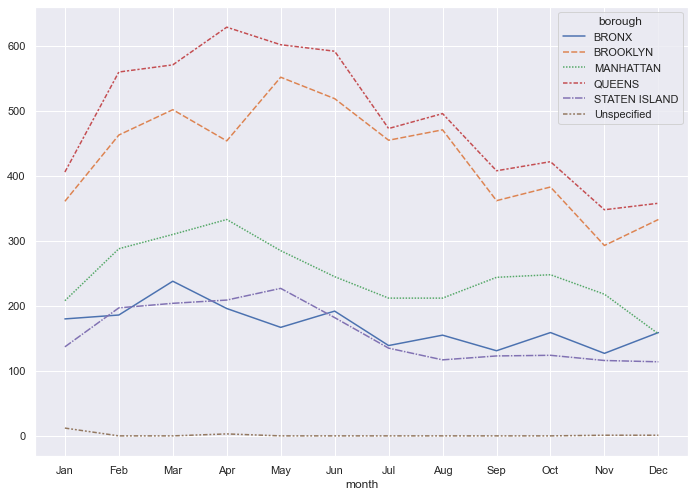

In [61]:
# Monthly trend of types of complaints -- also generates output file

#edit filters here
years=[2016,2017,2018]
months=[]
complains=['Street Condition']

saveAs=input('Save output as:- ')

#filter data
ndf=filterData(df)

# Total complaints for each borough
ndf=ndf[['borough','month','complaint_type']].groupby(['borough','month']).count().reset_index()
ndf.columns=['borough','month','total_complaints']

# create pivot table
ndfWide = ndf.pivot( "month","borough","total_complaints")

# sort chronologically and replace null values
new_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
ndfWide = ndfWide.reindex(new_order, axis=0)
ndfWide.fillna(0,inplace=True)

#seaborn figure
sns.set(rc={'figure.figsize':(11.7,8.27)})

#plot
sns.lineplot(data=ndfWide)

#format and save output file
ndfWide['month']=ndfWide.index
ndfWide['total complaints']=ndfWide.sum(axis=1)
ndfWide.to_csv(saveAs+'.csv',index=False)
print('Output has been saved in current folder')
ndfWide.head()

# Correlation of complaint types at week level

In [705]:
# Week number (1 to 53)
df['week']=df['created_date'].apply(lambda x: x.isocalendar().week)

<AxesSubplot:xlabel='complaint_type', ylabel='complaint_type'>

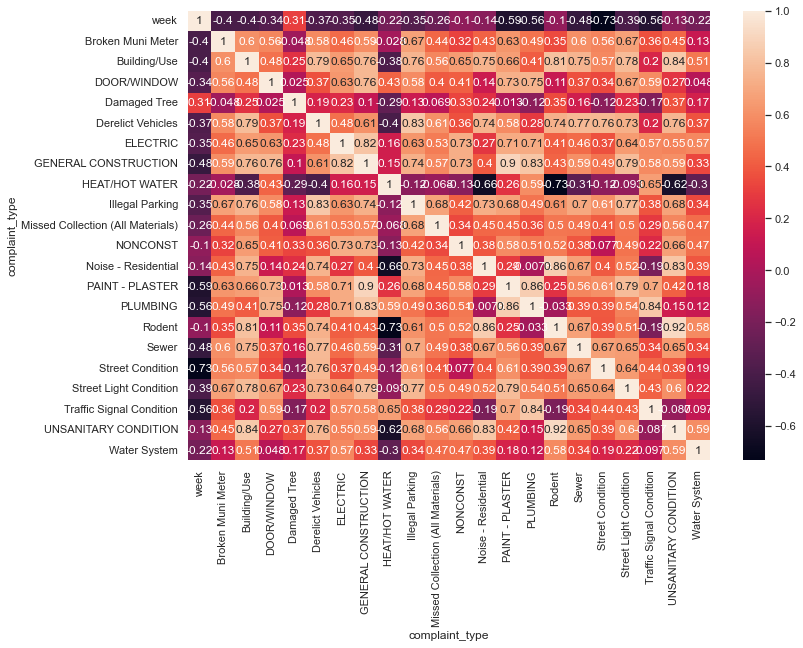

In [706]:
# Number of complaints in each complaint type for each week --- (top 21 complaint types)
ndf=df.loc[df.complaint_type.isin(topComplaints),['week','complaint_type']].groupby(['week','complaint_type']).size().reset_index()
ndf.columns=['week','complaint_type','total_complaints']

#Pivot
ndfWide = ndf.pivot( "week","complaint_type","total_complaints").reset_index()

#correlation matrix
cormat=ndfWide.corr()

#heatmap
sns.heatmap(cormat,annot=True)

# Correlation of complaint types at community board level

<AxesSubplot:xlabel='complaint_type', ylabel='complaint_type'>

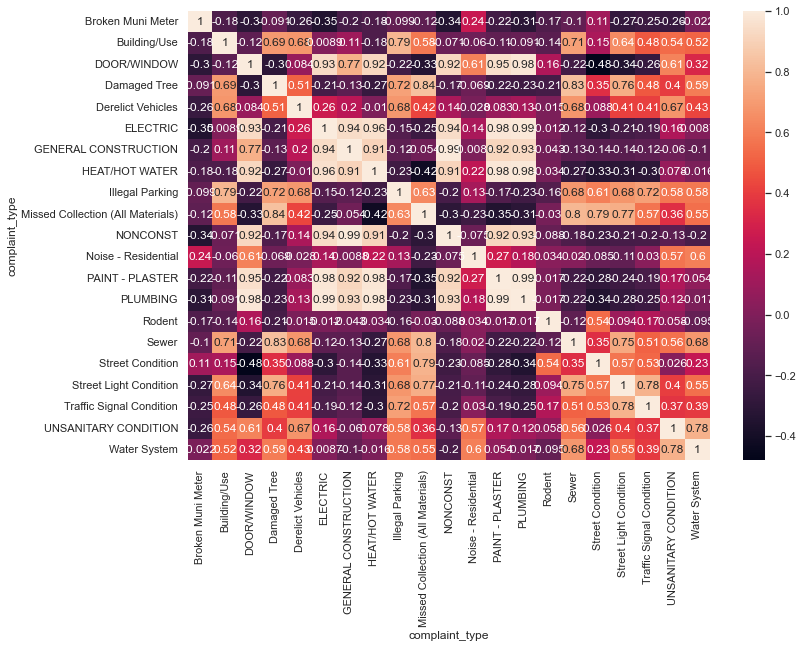

In [708]:
# Number of complaints in each complaint type for each community board --- (top 21 complaint types)
ndf=df.loc[df.complaint_type.isin(topComplaints),['community_board','complaint_type']].groupby(['community_board','complaint_type']).size().reset_index()
ndf.columns=['community_board','complaint_type','total_complaints']

#Pivot
ndfWide = ndf.pivot( "community_board","complaint_type","total_complaints").reset_index()

# Correlation matrix
cormat=ndfWide.corr()

#Heatmap
sns.heatmap(cormat,annot=True)

# Correlation of complaint types at zip code level

<AxesSubplot:xlabel='complaint_type', ylabel='complaint_type'>

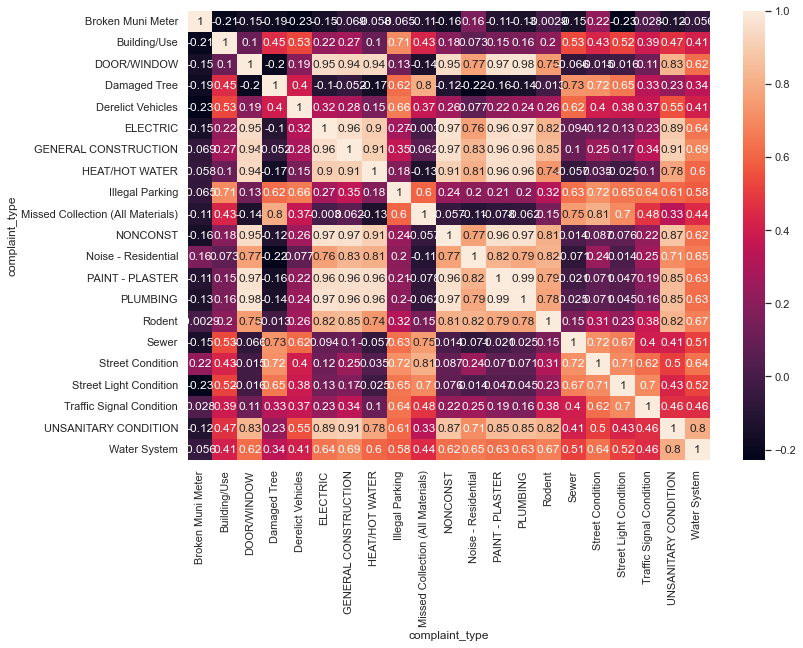

In [709]:
# Number of complaints in each complaint type for each zip code --- (top 21 complaint types)
ndf=df.loc[df.complaint_type.isin(topComplaints),['incident_zip','complaint_type']].groupby(['incident_zip','complaint_type']).size().reset_index()
ndf.columns=['incident_zip','complaint_type','total_complaints']

#Pivot
ndfWide = ndf.pivot( "incident_zip","complaint_type","total_complaints").reset_index()

#Correlation matrix
cormat=ndfWide.corr()

#Heatmap
sns.heatmap(cormat,annot=True)

# Time taken for complaint closing

In [710]:
#Calculate time taken
df['closed_date']=pd.to_datetime(df['closed_date'],infer_datetime_format=True)
df['time_taken']=df.closed_date-df.created_date

# Some issues should be solved sooner: Unsanitary condition, Noise, Illegal Parking, Heat/Hot Water, Street Condition

In [711]:
#Median time taken for complaint closing
time_df=df.groupby('complaint_type').agg({'time_taken':'median','descriptor':'count'}).reset_index()
time_df.columns=['complaint_type','time_taken','total_complaints']
time_df.sort_values('total_complaints',ascending=False)

,complaint_type,time_taken,total_complaints
145,Noise - Residential,0 days 02:44:02,148526
119,Illegal Parking,0 days 03:39:39.500000,104160
99,HEAT/HOT WATER,3 days 00:00:00,93962
191,Street Condition,3 days 15:20:29.500000,54144
213,UNSANITARY CONDITION,3 days 19:39:47,49413
156,PLUMBING,10 days 15:56:01.500000,43457
155,PAINT - PLASTER,12 days 06:01:21.500000,39990
96,GENERAL CONSTRUCTION,7 days 00:00:00,39545
228,Water System,0 days 06:32:00,28535
192,Street Light Condition,0 days 00:00:00,23967


# Analysis for efficient hiring of workers and inventory managment

In [713]:
#Distribution of complaints for each complaint type

complainType='PLUMBING'

# Select all years except 2019
recentdf=df.loc[(df.created_date<datetime(2019,1,1)),['complaint_type','descriptor','year']]

#Percentage Distribution of complaints 
frequent_df=round(100*recentdf[recentdf.complaint_type==complainType].descriptor.value_counts(normalize=True)).reset_index()
frequent_df.columns=['description','percentage']
frequent_df.percentage=frequent_df.percentage.astype(int).astype(str)+'%'

print('Distribution of complaints for each complaint type:-')
frequent_df.head(15)

Distribution of complaints for each complaint type:-


,description,percentage
0,WATER-LEAKS,19%
1,BASIN/SINK,17%
2,HEAVY FLOW,9%
3,TOILET,8%
4,SLOW LEAK,8%
5,WATER SUPPLY,7%
6,RADIATOR,7%
7,WATER-SUPPLY,6%
8,BATHTUB/SHOWER,6%
9,BATHTUB,4%


Enter file name to save output as :- plumbingYearly
Head of output file:-


descriptor,BASIN/SINK,HEAVY FLOW,SLOW LEAK,TOILET,WATER-LEAKS,year
year,,,,,,
2010,887.0,0.0,0.0,448.0,2026.0,2010
2011,873.0,0.0,0.0,421.0,2322.0,2011
2012,797.0,0.0,0.0,337.0,1449.0,2012
2013,672.0,0.0,0.0,343.0,1488.0,2013
2014,753.0,652.0,568.0,358.0,449.0,2014


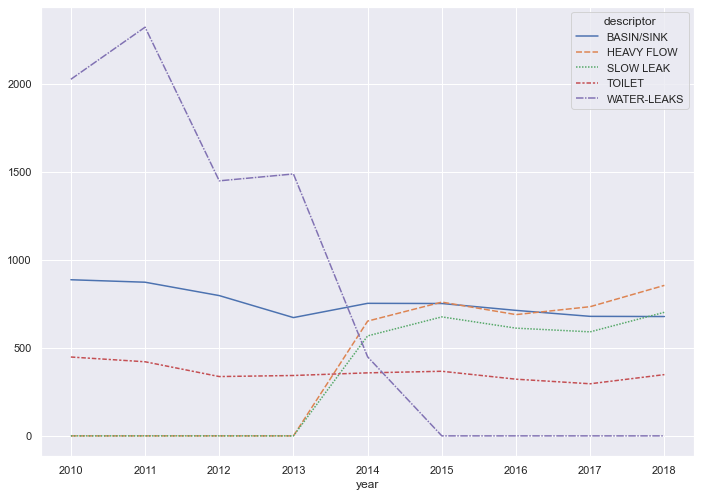

In [717]:
#Yearly trend of top complaints --- returns output file

saveAs=input('Enter file name to save output as :- ')

complainType='PLUMBING'

# top n complaints will be plotted for each complaint type
topN=5

# Year wise occurence of each complaint
chartdf=recentdf.loc[recentdf.descriptor.isin(frequent_df.description[:topN]),['descriptor','year','complaint_type']]
chartdf=chartdf.groupby(['year','descriptor'])['complaint_type'].size().reset_index()
chartdf.columns=['year','descriptor','total_complaints']

#Pivot and fill missing values
ndfWide = chartdf.pivot( "year","descriptor","total_complaints")
ndfWide.fillna(0,inplace=True)

# seaborn figure
sns.set(rc={'figure.figsize':(11.7,8.27)})

#plot
sns.lineplot(data=ndfWide)

#saving output
ndfWide['year']=ndfWide.index
ndfWide.to_csv(saveAs+'.csv',index=False)

print('Head of output file:-')
(ndfWide.head())

# Complaint type trend - For hiring or training of workers

In [735]:
# All years except 2019
recentdf=df.loc[df.year<2019,['complaint_type','descriptor','year']]

Year wise occurence of top 7 complaint types


<AxesSubplot:xlabel='year'>

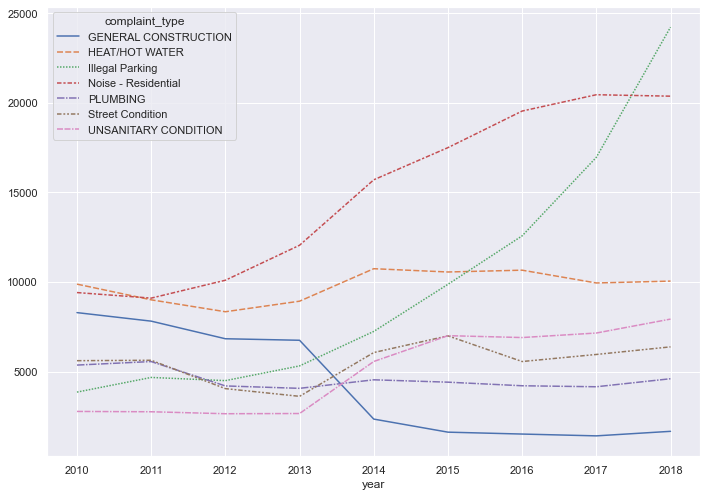

In [736]:
# Year wise occurence of top 7 complaint types

# total complaints of each complaint type in each year
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[:7])].groupby(['year','complaint_type'])['descriptor'].count().reset_index().sort_values('year')
trend1.columns=['year','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('year','complaint_type','total complaints')

#Plot
print('Year wise occurence of top 7 complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

Year wise occurence of 7-14 ranked(by occurence) complaint types


<AxesSubplot:xlabel='year'>

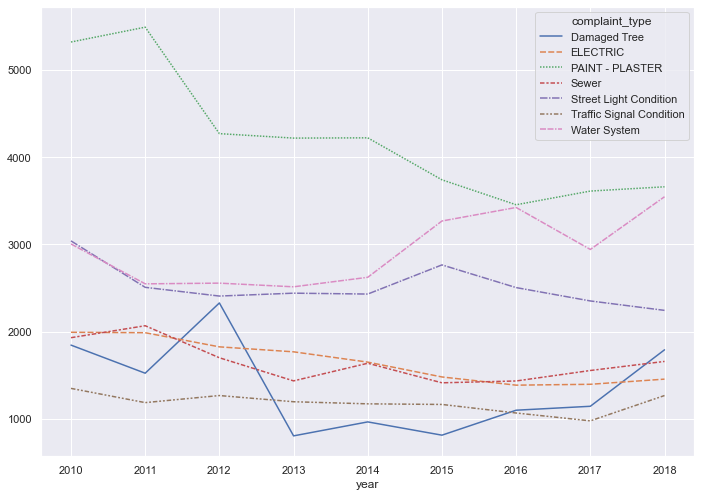

In [737]:
# Year wise occurence of 7-14 ranked(by occurence) complaint types

# total complaints of each complaint type in each year
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[7:14])].groupby(['year','complaint_type'])['descriptor'].count().reset_index().sort_values('year')
trend1.columns=['year','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('year','complaint_type','total complaints')

#Plot
print('Year wise occurence of 7-14 ranked(by occurence) complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

Year wise occurence of 14-21 ranked(by occurence) complaint types


<AxesSubplot:xlabel='year'>

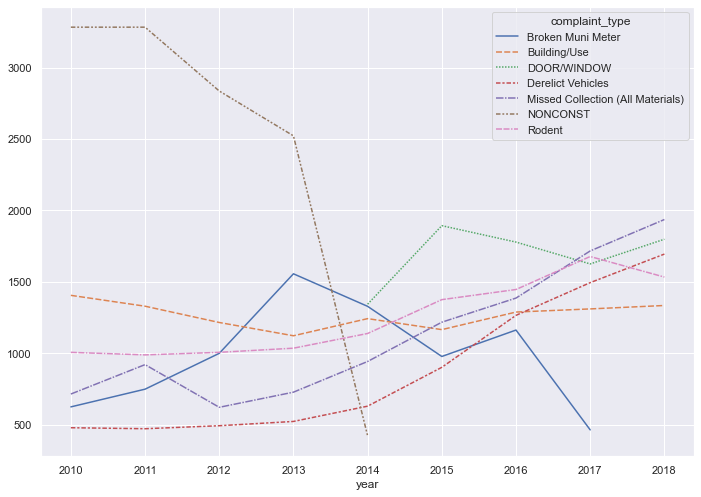

In [738]:
# Year wise occurence of 14-21 ranked(by occurence) complaint types

# total complaints of each complaint type in each year
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[14:21])].groupby(['year','complaint_type'])['descriptor'].count().reset_index().sort_values('year')
trend1.columns=['year','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('year','complaint_type','total complaints')

#Plot
print('Year wise occurence of 14-21 ranked(by occurence) complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

# Hourly trends - For planning shift timings for workers

Hourly trend for top 5 complaint types


<AxesSubplot:xlabel='hour'>

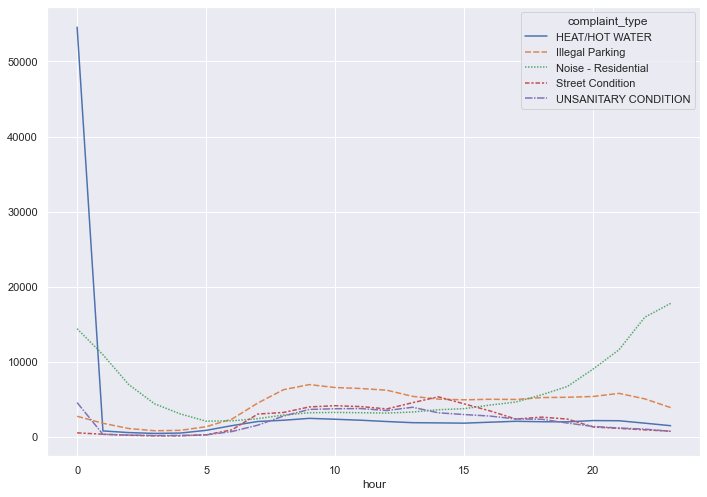

In [739]:
# Hourly trend for top 5 complaint types

#filter columns
recentdf=df[['complaint_type','descriptor','hour']]

#total complaints of each complaint type in each hour
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[:5])].groupby(['hour','complaint_type'])['descriptor'].count().reset_index().sort_values('hour')
trend1.columns=['hour','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('hour','complaint_type','total complaints')

#Plot
print('Hourly trend for top 5 complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

Hourly trend for 5-10 ranked(by occurence) complaint types


<AxesSubplot:xlabel='hour'>

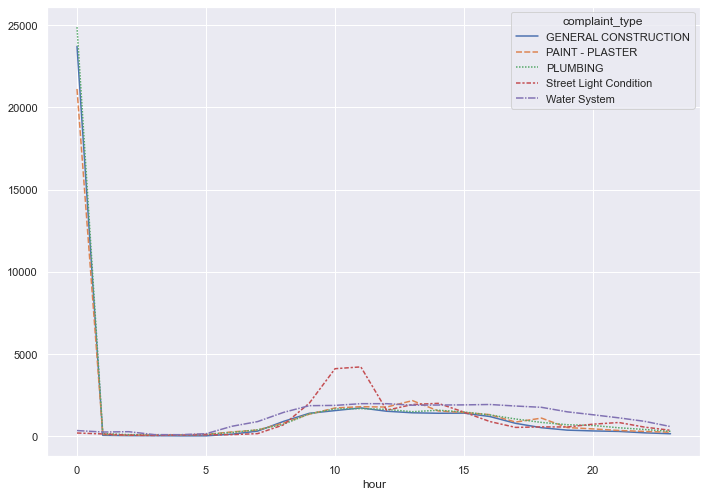

In [740]:
# Hourly trend for 5-10 ranked(by occurence) complaint types

#filter columns
recentdf=df[['complaint_type','descriptor','hour']]

#total complaints of each complaint type in each hour
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[5:10])].groupby(['hour','complaint_type'])['descriptor'].count().reset_index().sort_values('hour')
trend1.columns=['hour','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('hour','complaint_type','total complaints')

#Plot
print('Hourly trend for 5-10 ranked(by occurence) complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

Hourly trend for 10-15 ranked(by occurence) complaint types


<AxesSubplot:xlabel='hour'>

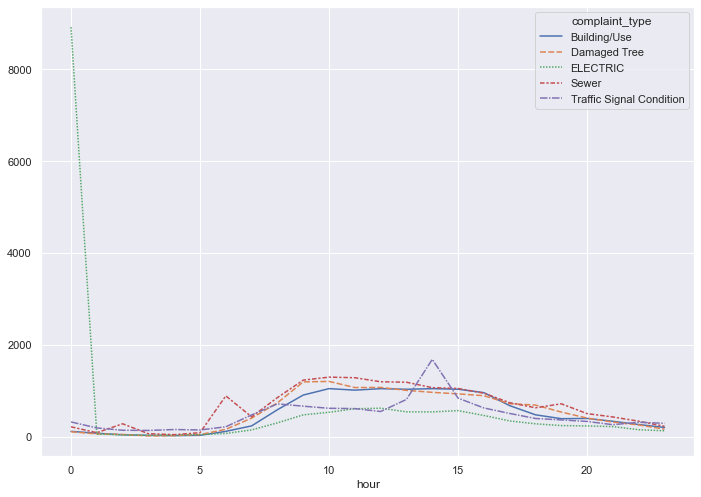

In [741]:
# Hourly trend for 10-15 ranked(by occurence) complaint types

#filter columns
recentdf=df[['complaint_type','descriptor','hour']]

#total complaints of each complaint type in each hour
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[10:15])].groupby(['hour','complaint_type'])['descriptor'].count().reset_index().sort_values('hour')
trend1.columns=['hour','complaint_type','total complaints']

#Pivot
trendWide1=trend1.pivot('hour','complaint_type','total complaints')

#Plot
print('Hourly trend for 10-15 ranked(by occurence) complaint types')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

# Analyzing festival months

Day-wise trend of 7 complaint types in December


<AxesSubplot:xlabel='day_of_month'>

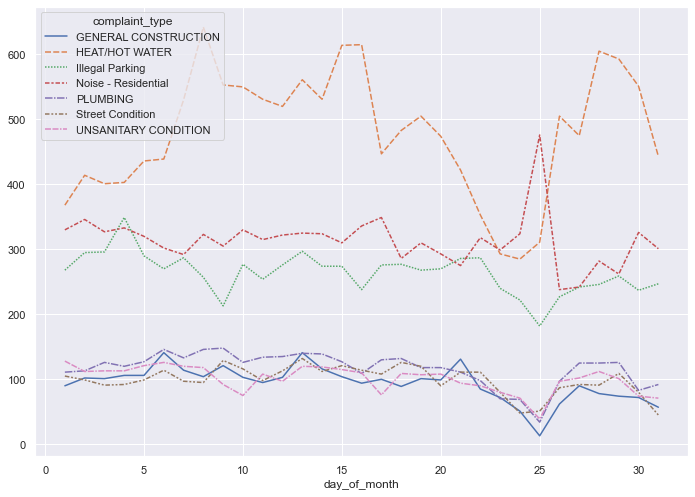

In [742]:
# Day-wise trend of 7 complaint types in December
months=['Dec']

# filter columns
recentdf=df.loc[df.month.isin(months),['complaint_type','descriptor','day_of_month']]

# total complaints of each type on each day of the selected months
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[:7])].groupby(['day_of_month','complaint_type'])['descriptor'].count().reset_index().sort_values('day_of_month')
trend1.columns=['day_of_month','complaint_type','total complaints']
trendWide1=trend1.pivot('day_of_month','complaint_type','total complaints')

#Plot
print('Day-wise trend of 7 complaint types in December')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

Day-wise trend of 7 complaint types in October and November


<AxesSubplot:xlabel='day_of_month'>

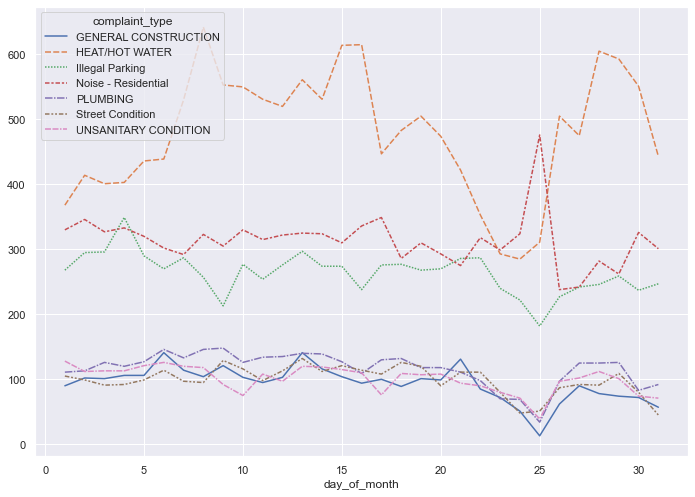

In [743]:
# Day-wise trend of 7 complaint types in October and November
months=['Dec']

# filter columns
recentdf=df.loc[df.month.isin(months),['complaint_type','descriptor','day_of_month']]

# total complaints of each type on each day of the selected months
trend1=recentdf[recentdf.complaint_type.isin(topComplaints[:7])].groupby(['day_of_month','complaint_type'])['descriptor'].count().reset_index().sort_values('day_of_month')
trend1.columns=['day_of_month','complaint_type','total complaints']
trendWide1=trend1.pivot('day_of_month','complaint_type','total complaints')

#Plot
print('Day-wise trend of 7 complaint types in October and November')
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(data=trendWide1)

In [755]:
################################# End of Notebook #################################